# KMeans clustering of Principal Components

we import the libraries

In [210]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as mplt
from sklearn.decomposition import PCA
import plotly.express as px
import warnings
import json
np.warnings = warnings # altrimenti numpy da problemi con pyclustering, TODO: è un problema solo mio?
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score, silhouette_score, silhouette_samples, adjusted_rand_score
from sklearn.metrics import homogeneity_score, completeness_score, normalized_mutual_info_score
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
from sklearn.cluster import KMeans, BisectingKMeans
from scipy.spatial.distance import pdist, squareform
from pyclustering.cluster.xmeans import xmeans, splitting_type
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
import utm
import os
import sys
sys.path.append(os.path.abspath('..'))
from plot_utils import *
from clustering_utils import *
%matplotlib inline
pd.set_option('display.max_columns', None)
pd.set_option('max_colwidth', None)

and we load all the data usefoul for the analysis

In [211]:
incidents_df = pd.read_csv(
    '../data/incidents_indicators.csv',
    index_col=0
)

f = open('../data/indicators_names.json')
features_to_cluster = json.loads(f.read())

categorical_features = [
    'year', 'month', 'day_of_week', 'party', #'state', 'address_type', 'county', 'city'
    'firearm', 'air_gun', 'shots', 'aggression', 'suicide',
    'injuries', 'death', 'road', 'illegal_holding', 'house',
    'school', 'children', 'drugs', 'officers', 'organized', 'social_reasons',
    'defensive', 'workplace', 'abduction', 'unintentional'
    # 'incident_characteristics1', 'incident_characteristics2'
    ]
# other interesting features:
# poverty_perc, date
incidents_df = incidents_df.dropna(subset=features_to_cluster)

we select the features we want to use for clustering

In [212]:
features_to_cluster_no_coord = features_to_cluster[2:]
features_to_cluster_no_coord

['location_imp',
 'surprisal_address_type',
 'age_range',
 'avg_age',
 'surprisal_min_age',
 'n_child_prop',
 'n_teen_prop',
 'surprisal_age_groups',
 'n_killed_prop',
 'n_injured_prop',
 'n_unharmed_prop',
 'n_males_prop',
 'surprisal_n_males',
 'surprisal_characteristics',
 'n_arrested_prop',
 'n_participants',
 'surprisal_day']

In [213]:
incidents_df[features_to_cluster_no_coord].describe()

,location_imp,surprisal_address_type,age_range,avg_age,surprisal_min_age,n_child_prop,n_teen_prop,surprisal_age_groups,n_killed_prop,n_injured_prop,n_unharmed_prop,n_males_prop,surprisal_n_males,surprisal_characteristics,n_arrested_prop,n_participants,surprisal_day
count,1.318110e+05,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000,131811.00000,131811.000000,131811.000000,131811.000000,131811.000000,131811.000000
mean,1.360195e-02,1.405525,3.456138,30.200264,4.901767,0.011723,0.075311,2.339911,0.220584,0.300006,0.158516,0.87350,1.854277,3.773041,0.321602,1.817299,5.716236
std,4.479459e-02,1.469670,8.140794,12.340120,1.097396,0.096645,0.244843,1.574419,0.360213,0.394918,0.295476,0.25724,1.275196,1.667965,0.409666,1.107308,1.153584
min,1.000000e-07,-0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,0.000000,0.00000,-0.000000,-0.000000,0.000000,1.000000,-0.000000
25%,1.000000e-07,0.398084,0.000000,21.000000,4.169925,0.000000,0.000000,1.222392,0.000000,0.000000,0.000000,1.00000,0.947533,2.465123,0.000000,1.000000,4.963474
50%,1.000000e-05,0.681367,0.000000,27.000000,4.807355,0.000000,0.000000,1.807355,0.000000,0.000000,0.000000,1.00000,1.392317,3.668379,0.000000,2.000000,5.754888
75%,1.000000e-05,2.152003,2.000000,36.000000,5.554589,0.000000,0.000000,2.982977,0.500000,0.500000,0.250000,1.00000,2.321928,5.000000,0.600000,2.000000,6.491853
max,6.467426e-01,9.489848,82.000000,101.000000,9.614710,1.000000,1.000000,9.614710,1.000000,1.000000,1.000000,1.00000,9.489848,9.614710,1.000000,63.000000,9.614710


we display the distribution of the selected features 

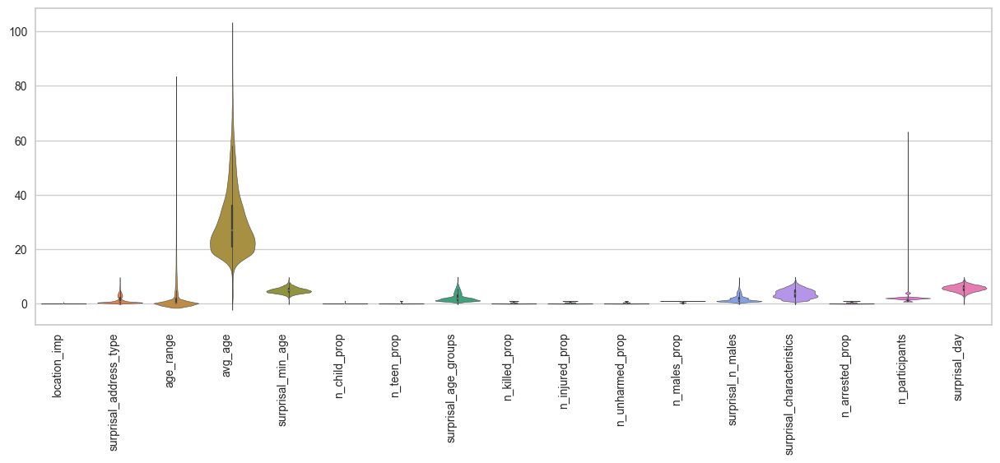

In [214]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.violinplot(data=incidents_df[features_to_cluster_no_coord],ax=ax)
plt.xticks(rotation=90, ha='right');

in order to obtain meaningful results, we must ensure that there is no feature that presents too high magnitude that outweighs the others, to implement this we normalise all ranges between 0 and 1

In [215]:
from sklearn.preprocessing import MinMaxScaler
scaler_obj = MinMaxScaler()
normalized_indicators = pd.DataFrame(data=scaler_obj.fit_transform(incidents_df[features_to_cluster_no_coord].values), columns=features_to_cluster_no_coord)

the features distribution after the normalization, the shape is untouched but now there are all included in the same range of values

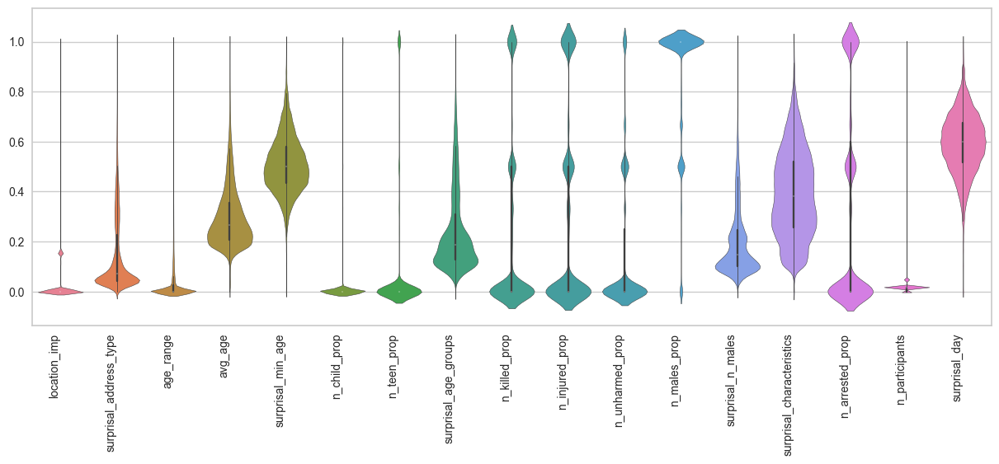

In [216]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.violinplot(data=normalized_indicators,ax=ax)
plt.xticks(rotation=90, ha='right');

## Computing the PCA decomposition

below we use the object PCA and the funtion fit_transform implemented in the [Sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) library to calculate the principal component decomposition of the indicators chosen for clustering

In [217]:
pca = PCA()
X_pca = pca.fit_transform(normalized_indicators)
pca_df = pd.DataFrame(index=incidents_df.index)

We now expose the records in the new vector space composed of the 2 most relevant eigenvectors, in relations, in relation to the value of an original feature for every original feature

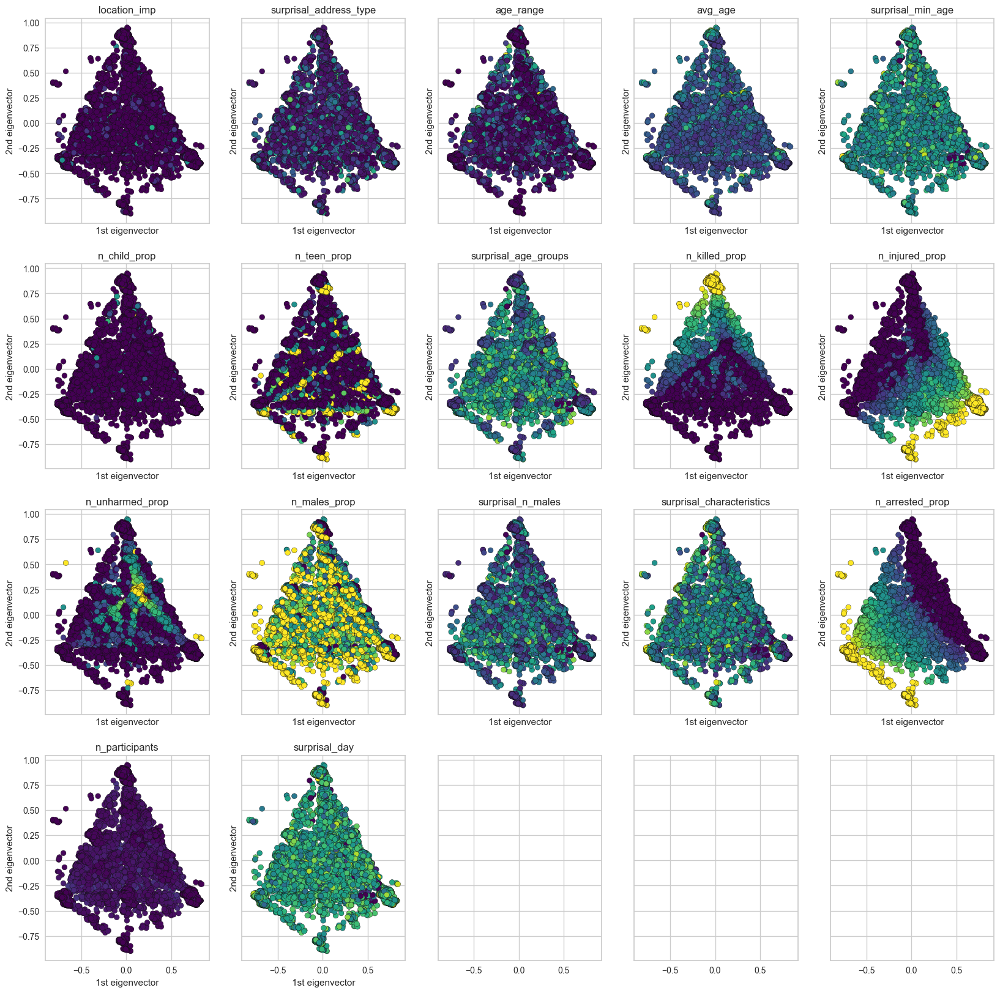

In [218]:
nrows=4
ncols=5
row=0
fig, axs = mplt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20), sharex=True, sharey=True)
for i, col in enumerate(normalized_indicators.columns):
    if i != 0 and i % ncols == 0:
        row += 1
    axs[row][i % ncols].scatter(X_pca[:, 0], X_pca[:, 1], edgecolor='k', s=40, c=normalized_indicators[col], cmap='viridis')
    axs[row][i % ncols].set_title(col)
    axs[row][i % ncols].set_xlabel("1st eigenvector")
    axs[row][i % ncols].set_ylabel("2nd eigenvector")

we observe correlation between the first and second eigenvector and some original features, in particular:

- the first eighenvector is slightly correlated with 'n_injured_prop' and 'n_arrested_prop'
- the second is strictly correlated with 'n_killed_prop'

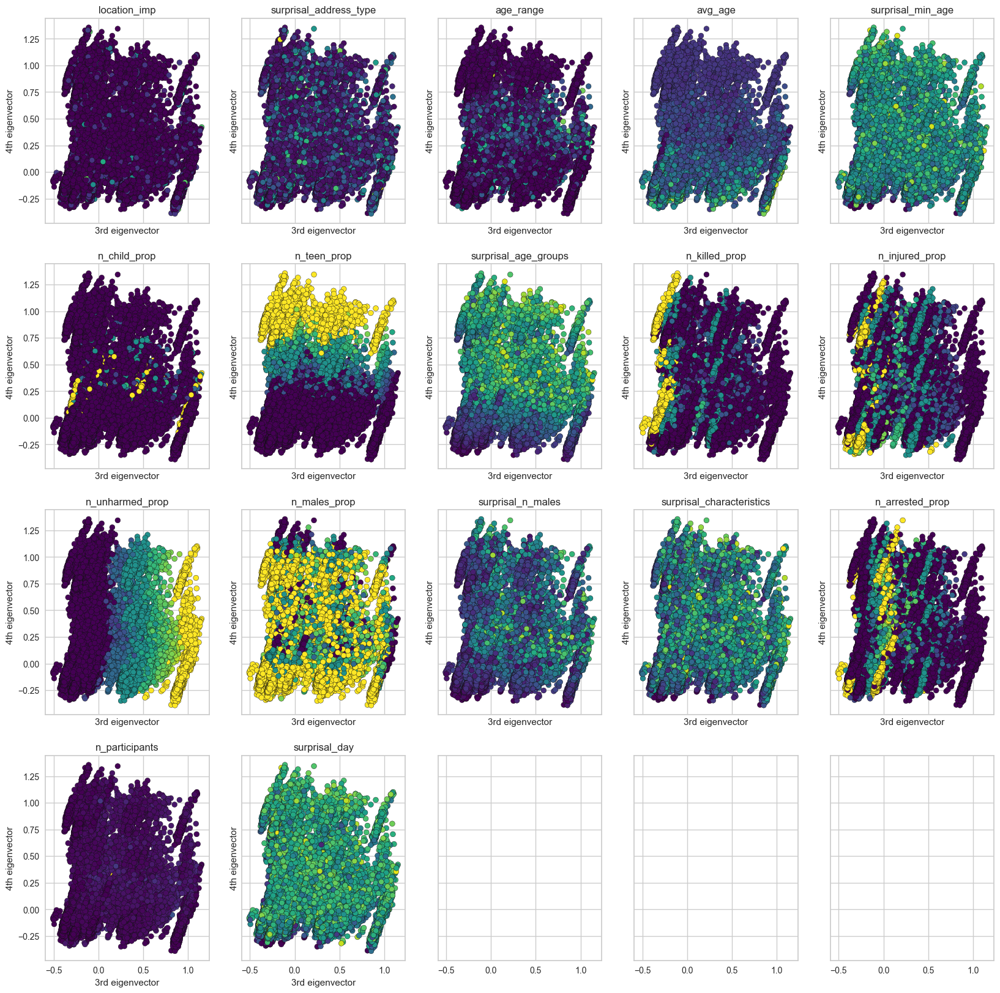

In [219]:
nrows=4
ncols=5
row=0
fig, axs = mplt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20), sharex=True, sharey=True)
for i, col in enumerate(normalized_indicators.columns):
    if i != 0 and i % ncols == 0:
        row += 1
    axs[row][i % ncols].scatter(X_pca[:, 2], X_pca[:, 3], edgecolor='k', s=40, c=normalized_indicators[col], cmap='viridis')
    axs[row][i % ncols].set_title(col)
    axs[row][i % ncols].set_xlabel("3rd eigenvector")
    axs[row][i % ncols].set_ylabel("4th eigenvector")

Above we have the same plot as before, but taking in to consideration the third and the fourth eigenvector, and here too we observe correlation between the two eigenvector and some original features, in particular:

- the third eighenvector is strongly correlated with 'n_unharmed_prop' and slightly with 'n_arrested_prop', 'n_killed_prop' and 'n_injured_prop'
- the fourth is strictly correlated with 'n_teen_prop' and slightly with 'avg_age'

we display every incident in the vector space formed by the first 3 eigenvectors

In [220]:
x = X_pca[:, 0]
y = X_pca[:, 2]
z = X_pca[:, 1]
fig = px.scatter_3d(x=x, y=y, z=z, labels={'x': '1st eigenvector', 'y': '3rd eigenvector', 'z': '2nd eigenvector'})
fig.show()

Now we want to understand the relevance of each component identified by the PCA, to narrow the clustering down to the most relevant ones, which alone can best approximate the entire dataset, to do this we plot the explained variance of each component, and relate it to the previous one

[0, 1, 2.5, 3.5, 4.5, 6.0, 7.0, 8.0, 9.5, 10.5, 12.0, 13.0, 14.5, 15.5, 16.5, 18.0]


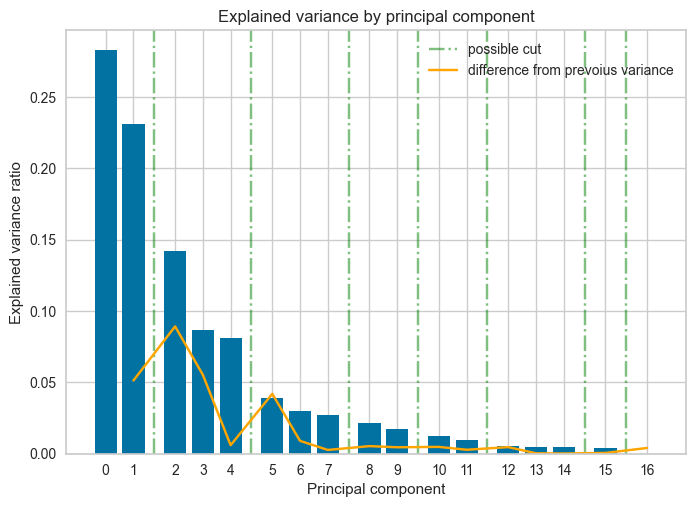

In [221]:
exp_var_pca = pca.explained_variance_ratio_
diff_var = []

for i, var in enumerate(exp_var_pca[:-1]):
    diff_var.append( var-exp_var_pca[i+1])


xtick = []
gap = 0
for i, var in enumerate(diff_var):
    xtick.append(i+gap)
    if i != 0 and diff_var[i-1] <= var:
        gap += 0.5
        if gap == 0.5:
            plt.axvline(x = i+gap+0.25, color = 'green', linestyle = '-.', alpha=0.5, label='possible cut')
        else:
            plt.axvline(x = i+gap+0.25, color = 'green', linestyle = '-.', alpha=0.5)
    
print(xtick)
#xtick = [0,1,2,3,4,5.5,6.5,7.5,8.5,9.5,10.5,12,13,14,15,16,17,18,19,20]
#diff_var = list(zip(xtick, diff_var))
xtick.append(xtick[-1]+1.5)

plt.bar(xtick, exp_var_pca, align='center')
plt.plot(xtick[1:], diff_var, label='difference from prevoius variance', color='orange')

plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component')
plt.title('Explained variance by principal component')
plt.xticks(xtick, range(exp_var_pca.shape[0]))
plt.legend();

Of all the possible divisions identified, the most significant are the third, fourth and fifth, as we cannot afford a high reconstruction error

In [222]:
def get_reconstruction_error(x_pca, x_orig, pca, n_comp):
    dummy = np.matmul(x_pca[:,:n_comp], pca.components_[:n_comp,:]) + pca.mean_
    return pd.DataFrame(index=x_orig.index, data=np.sum((dummy - x_orig.values)**2, axis=1))

In [223]:
pca_col = ['1st_comp',
 '2nd_comp',
 '3rd_comp',
 '4th_comp',
 '5th_comp',
 '6th_comp',
 '7th_comp',
 '8th_comp',
 '9th_comp',
 '10th_comp',
 '11th_comp',
 '12th_comp',
 '13th_comp',
 '14th_comp',
 '15th_comp',
 '16th_comp',
 '17th_comp']

In [224]:
pca_indicators = pd.DataFrame(index=normalized_indicators.index, data=X_pca, columns=pca_col)

we calculate the dataset reconstruction error for the first 8, 10 and 12 components. 

defined as the error between the original dataset and the one generated by using only k components.

In [225]:
pca_indicators['PCA_rec_error_8C'] = get_reconstruction_error(X_pca, normalized_indicators, pca, 8)
pca_indicators['PCA_rec_error_10C'] = get_reconstruction_error(X_pca, normalized_indicators, pca, 10)
pca_indicators['PCA_rec_error_12C'] = get_reconstruction_error(X_pca, normalized_indicators, pca, 12)

In [226]:
pca_indicators.sample(3)

,1st_comp,2nd_comp,3rd_comp,4th_comp,5th_comp,6th_comp,7th_comp,8th_comp,9th_comp,10th_comp,11th_comp,12th_comp,13th_comp,14th_comp,15th_comp,16th_comp,17th_comp,PCA_rec_error_8C,PCA_rec_error_10C,PCA_rec_error_12C
21656,-0.695804,-0.365950,-0.094205,-0.174288,-0.065200,-0.063981,0.160727,-0.073870,0.265712,-0.068836,0.063188,-0.016532,-0.071775,0.043838,0.099120,-0.017772,0.006684,0.096866,0.021525,0.017259
64224,0.763349,-0.317993,-0.131565,0.077243,0.891710,-0.192867,-0.109027,0.049061,0.223207,-0.070096,-0.103053,-0.116569,-0.126785,0.082894,-0.020398,-0.031882,-0.008159,0.103388,0.048653,0.024445
91992,-0.380421,0.281912,-0.113296,0.057351,0.420389,0.137512,0.234282,-0.198505,0.224413,0.230250,0.060057,-0.028861,0.204807,-0.047608,-0.059597,0.039898,0.002642,0.157179,0.053803,0.049363


we display the distribution of the principal components but also the recostruction error calculate before

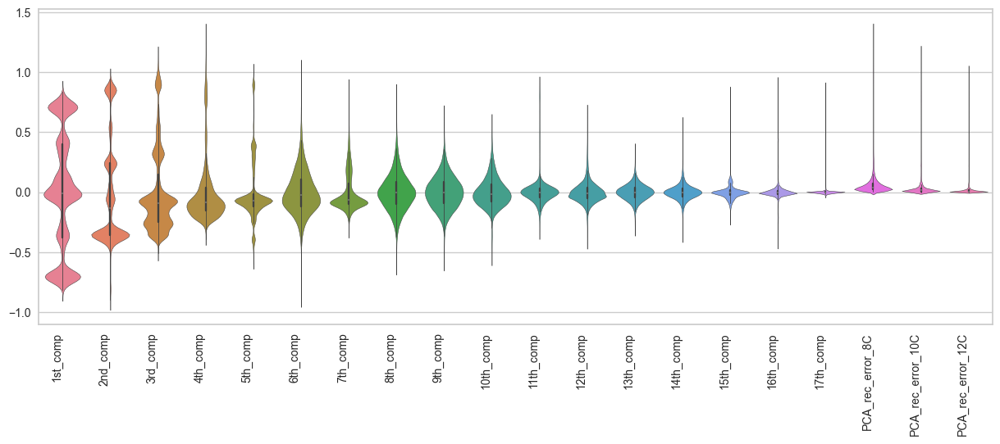

In [227]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.violinplot(data=pca_indicators,ax=ax)
plt.xticks(rotation=90, ha='right');

we normalize the previous distribution, because we will use this components for the clustering, and we want uniformity between the new features identified

In [228]:
pca_normalized_indicators = pd.DataFrame(data=scaler_obj.fit_transform(pca_indicators.values), columns=pca_indicators.columns)

we display the normalized distributions

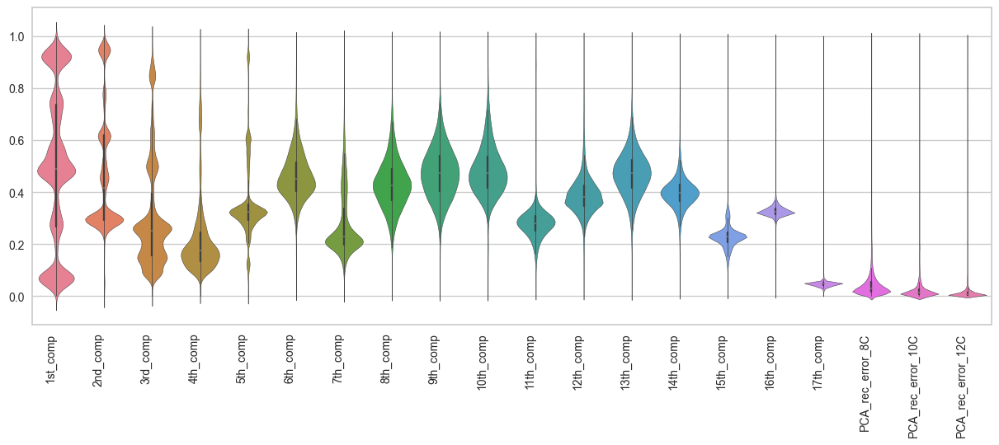

In [229]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.violinplot(data=pca_normalized_indicators,ax=ax)
plt.xticks(rotation=90, ha='right');

Ultimately, we choose to use the first 10 components for clustering, because it seems the best compromise between a small number of components but still being able to approximate the original features well.

Below we can see the reconstruction error generated by these 10 components, and we can see that it is quite uniform and close to zero

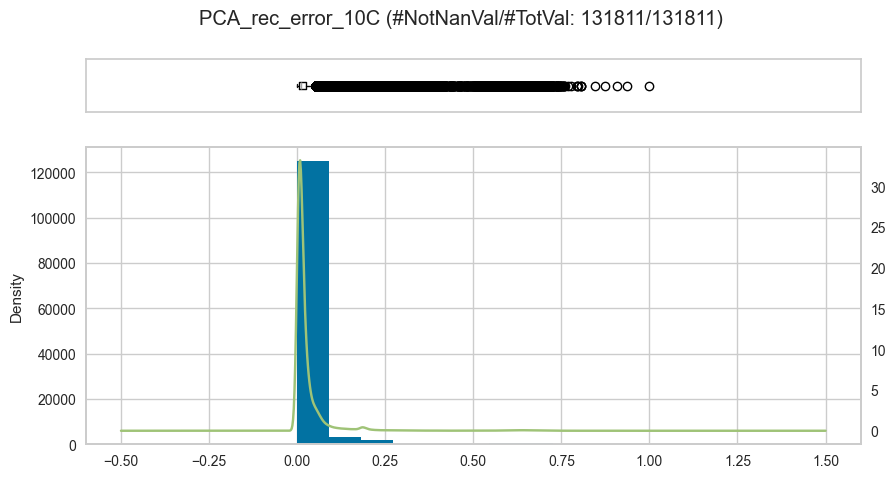

In [234]:
hist_box_plot(
    pca_normalized_indicators,
    'PCA_rec_error_10C',
    title='PCA_rec_error_10C',
    bins=int(np.log(pca_normalized_indicators.shape[0])), # Sturger's rule
    figsize=(10, 5)
)

In [237]:
clustered_components = pca_col[:-7]
X = pca_normalized_indicators[clustered_components].values

Below we define the parameters of the k-means algorithm:
- 300 iterations should be enough to converge (it is the default parameter of the scikit-learn implementation)
- the algorithm is run 10 times with different initializations and the best result in terms of SSE is chosen (10 runs is the default parameter of the scikit-learn implementation)
- initial centroids are sampled based on an empirical probability distribution of the points’ contribution to the overall inertia (this method is called k-means++ and again it is the default parameter of the scikit-learn implementation)
- the maximum number of K to later be evaluated is 30 (higher values lead to results that are difficult to interpret)
- we fixed the random seed to make the results reproducible

In [239]:
MAX_ITER = 300
N_INIT = 10
INIT_METHOD = 'k-means++'
MAX_K = 30
RANDOM_STATE = 7

## Identification of the best value of k

The following function uses the implementation of the elbow method from the library [Yellowbrick](https://www.scikit-yb.org/en/latest/index.html), to identify the best value of k. This method consists in computing a metric to evaluate the quality of the clustering for each value of k, and then plotting the metric as a function of k. The best value of k is the one that corresponds to the point of inflection of the curve (the point where the metric starts to decrease more slowly).

In [240]:
def apply_k_elbow_method(X, kmeans_params, metric, start_k, max_k, plot_elbow=True):
    if metric == 'SSE':
        metric = 'distortion'
        metric_descr = 'SSE'
    elif metric == 'calinski_harabasz':
        metric_descr = 'Calinski Harabasz Score'
    elif metric == 'silhouette':
        metric_descr = 'Silhouette Score'
    else:
        raise ValueError('Metric not supported')
    
    _, axs = plt.subplots(nrows=1, ncols=len(max_k) if len(max_k)!= 1 else 2, figsize=(30,5))

    for i in range(len(max_k)):
        kmeans_params['n_clusters'] = i
        kmeans = KMeans(**kmeans_params)

        elbow_vis = KElbowVisualizer(kmeans, k=(start_k, max_k[i]), metric=metric, timings=False, ax=axs[i], locate_elbow=plot_elbow)
        elbow_vis.fit(X)
        axs[i].set_title(f'{metric_descr} elbow for K-Means clustering (K in [{str(start_k)}, {str(max_k[i] - 1)}])')
        axs[i].set_ylabel(metric_descr)
        axs[i].set_xlabel('K')
        if plot_elbow:
            axs[i].legend([
                f'{metric_descr}',
                f'elbow at K = {str(elbow_vis.elbow_value_)}, {metric_descr} = {elbow_vis.elbow_score_:0.2f}'
            ])
        else:
            axs[i].legend([
                f'{metric_descr}'
            ])

        if len(max_k)==1:
            axs[1].remove()
    
    plt.show()

Now we apply the elbow method evaluating the SSE and computing the elbow for each value of k between 1 and 10, 1 and 20 and 1 and 30. We consider also k=1 (absence of clusters) and we repeat the analysis with k in different ranges because the inflection point of the curve could vary depending on the number of points the curve is made of.

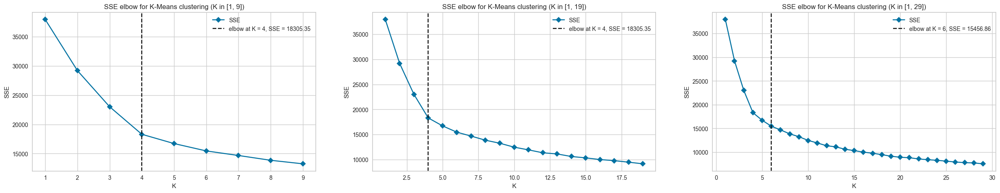

In [241]:
kmeans_params = {'init': INIT_METHOD, 'n_init': N_INIT, 'max_iter': MAX_ITER, 'random_state': RANDOM_STATE}
apply_k_elbow_method(X=X, kmeans_params=kmeans_params, metric='SSE', start_k=1, max_k=[10, 20, 30])

The elbow method identifies k=4, k=6 as best possible values of k.

At both points found we can see a large decrease in the rate of decrease, and being very close to each other we can say that the features chosen are also uniform in this aspect.

In [248]:
best_k = [4, 6]

We repeat the analysis using the silhouette score.

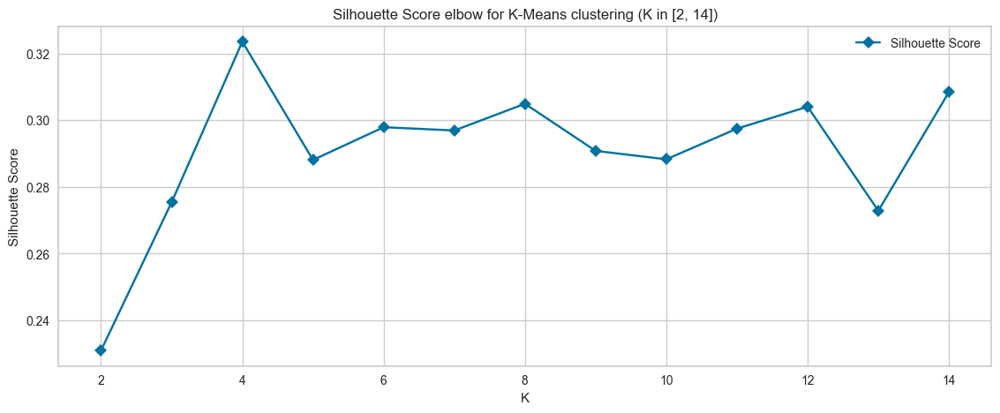

In [243]:
apply_k_elbow_method(X=X, kmeans_params=kmeans_params, metric='silhouette', start_k=2, max_k=[15], plot_elbow=False)

The curve generated above is not monotonic, like the previous one, in fact there are several local maxima at k equals to 4, 6, 8, 12 and 14, and probably if we increase k we will find other local and maybe global maxima, but having too many clusters is not positive.

we chose, using this score, k equals to 4, 8, 12, and 14 but keep in mind that k = 4 is the global maxima

In [249]:
best_k += [4, 8, 12, 14]

We repeat again the analysing evaluating the Calinski-Harabasz score (the ratio of the sum of between-cluster dispersion and of within-cluster dispersion; the higher it is the better the clustering).

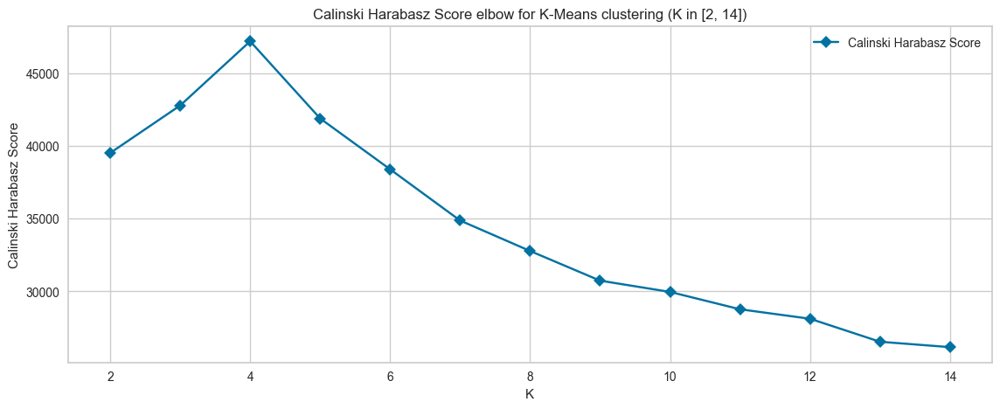

In [245]:
apply_k_elbow_method(X=X, kmeans_params=kmeans_params, metric='calinski_harabasz', start_k=2, max_k=[15], plot_elbow=False)

In the graph above, the best value of k is clear, as there is a single clear global maximum with k=4

In [250]:
best_k += [4]
best_k = sorted(list(set(best_k)))
best_k

[4, 6, 8, 12, 14]

To identify the best value of k we also apply the X-means algorithm from the library [pyclustering](https://github.com/annoviko/pyclustering/), which is a variation of the k-means algorithm that should automatically find the best value of k. The algorithm starts with k=2 and then it iteratively splits the clusters until a score does not improve anymore. The implementation we will use supports both the BIC score (Bayesian Information Criterion) and the Minimum Noiseless Descriptionlength score (MDL):

In [251]:
initial_centers = kmeans_plusplus_initializer(data=X, amount_centers=1, random_state=RANDOM_STATE).initialize()
xmeans_MDL_instance = xmeans(
    data=X,
    initial_centers=initial_centers,
    kmax=MAX_K,
    splitting_type=splitting_type.BAYESIAN_INFORMATION_CRITERION,
    random_state=RANDOM_STATE
)
xmeans_MDL_instance.process()
n_xmeans_BIC_clusters = len(xmeans_MDL_instance.get_clusters())
print(f'Number of clusters found by xmeans using BIC score and setting the maximum number of clusters to {MAX_K}: {n_xmeans_BIC_clusters}')

Number of clusters found by xmeans using BIC score and setting the maximum number of clusters to 30: 30


In [252]:
xmeans_MDL_instance = xmeans(
    data=X,
    initial_centers=initial_centers,
    kmax=MAX_K,
    splitting_type=splitting_type.MINIMUM_NOISELESS_DESCRIPTION_LENGTH,
    random_state=RANDOM_STATE
)
xmeans_MDL_instance.process()
n_xmeans_MDL_clusters = len(xmeans_MDL_instance.get_clusters())
print(f'Number of clusters found by xmeans using MDL score and setting the maximum number of clusters to {MAX_K}: {n_xmeans_MDL_clusters}')

Number of clusters found by xmeans using MDL score and setting the maximum number of clusters to 30: 30


X-means terminates with k equal to the maximum number of clusters allowed (30 in our case). This means that the score always improved when splitting the clusters. It is not possible to clearly identify a best K-value using this criteria, as the best k imposes too many clusters for these to remain relevant.

To choose the best value of k among the ones identified by the elbow method, we will compute other metrics to evaluate the quality of the clustering. The following function fits the k-means algorithm with a given set of parameters and computes the following metrics:
- SSE
- BSS (i.e. between-cluster sum of squares; the higher the better)
- Davies-Bouldin score (i.e. the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances; the lower the better)
- Calinski-Harabasz score
- Silhouette score

In [253]:
def fit_kmeans(X, params):
    print(f"Fitting KMeans with k = {params['n_clusters']}")
    kmeans = KMeans(**params)
    kmeans.fit(X)
    results = {}
    results['model'] = kmeans
    results['SSE'] = kmeans.inertia_
    results['BSS'] = compute_bss_per_cluster(X=X, clusters=kmeans.labels_, centroids=kmeans.cluster_centers_, weighted=True).sum()
    results['davies_bouldin_score'] = davies_bouldin_score(X=X, labels=kmeans.labels_)
    results['calinski_harabasz_score'] = calinski_harabasz_score(X=X, labels=kmeans.labels_)
    results['silhouette_score'] = silhouette_score(X=X, labels=kmeans.labels_) 
    results['n_iter'] = kmeans.n_iter_
    return results

To study the effect of the centroids initialization on the results, we will apply the algorithm using the k-means++ initialization repeated 10 times (as previously done)

In [254]:
results = {}
kmeans_params = {}
kmeans_params['random_state'] = RANDOM_STATE
kmeans_params['max_iter'] = MAX_ITER
best_k = sorted(best_k)
for k in best_k:
    kmeans_params['n_init'] = N_INIT
    kmeans_params['n_clusters'] = k
    kmeans_params['init'] = INIT_METHOD
    result = fit_kmeans(X=X, params=kmeans_params)
    results[str(k)+'_means'] = result

Fitting KMeans with k = 4


Fitting KMeans with k = 6
Fitting KMeans with k = 8
Fitting KMeans with k = 12
Fitting KMeans with k = 14


In [255]:
results_df = pd.DataFrame(results).T
results_df.drop(columns=['model'])

,SSE,BSS,davies_bouldin_score,calinski_harabasz_score,silhouette_score,n_iter
4_means,18305.348439,19658.272828,1.20318,47182.621765,0.323521,4
6_means,15456.863569,22506.989109,1.381129,38384.094779,0.297882,23
8_means,13852.767292,24111.127348,1.389156,32771.883493,0.304901,11
12_means,11344.086077,26618.260214,1.409811,28115.676488,0.304028,13
14_means,10602.07617,27362.344516,1.438507,26164.385843,0.308434,21


We observe that:
- SSE is best for k=4, but this metric is expected to decrease increasing the number of clusters
- BSS is best for k=14, but this metric is inversely proportional to the previous one
- Davies-Bouldin score is best for k=14
- Calinski-Harabasz score is best for k=4 by a large margin
- Silhouette score is best for k=4

In [256]:
best_k = [4, 14]
best_k

[4, 14]

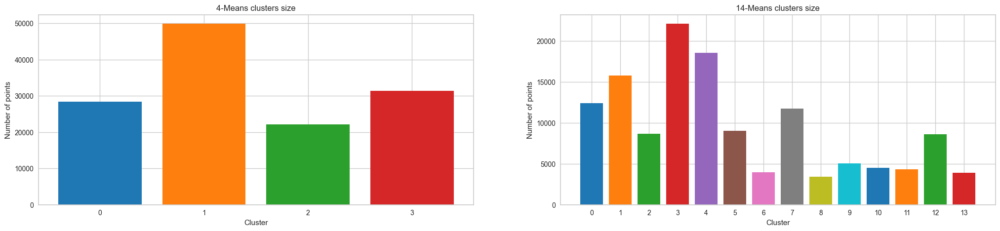

In [257]:
fig, axs = plt.subplots(nrows=1, ncols=len(best_k), figsize=(25,5))
for i in range(len(best_k)):
    k = best_k[i]
    plot_clusters_size(clusters=results[f'{k}_means']['model'].labels_, ax=axs[i], title=f'{best_k[i]}-Means clusters size', color_palette=sns.color_palette('tab10'))

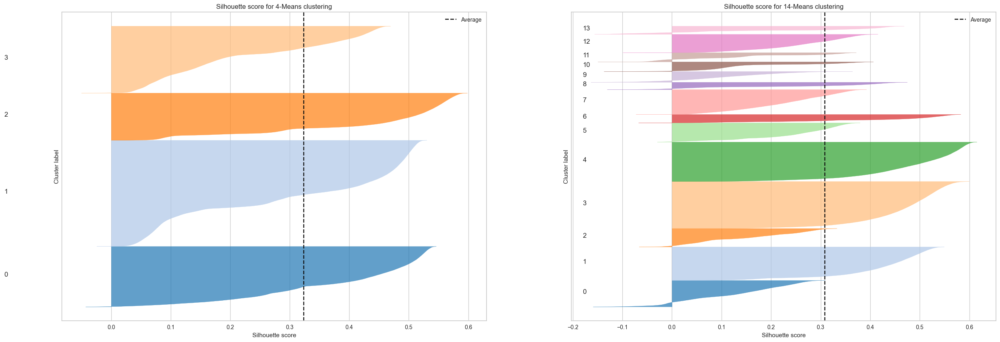

In [258]:
fig, axs = plt.subplots(nrows=1, ncols=len(best_k), figsize=(30,10), sharey=True)
for i in range(len(best_k)):
    clusters = results[f'{best_k[i]}_means']['model'].labels_
    silhouette_per_point = silhouette_samples(X=X, labels=clusters)
    results[f'{best_k[i]}_means']['silhouette_per_point'] = silhouette_per_point
    plot_scores_per_point(
        score_per_point=silhouette_per_point,
        clusters=clusters,
        score_name='Silhouette score', ax=axs[i],
        title=f'Silhouette score for {best_k[i]}-Means clustering',
        color_palette=sns.color_palette('tab20'),
        minx=-0.18
    )

For both the two best k values identified (4 and 14), the resulting clusters are well-balanced and evenly divide the records. The difference between the quantity of records in the largest and smallest clusters is similar between the two solutions.

For k=4, we can observe fewer data points with negative silhouettes. However, for k=14, they are generally more frequent, especially within the smaller-sized clusters.

In conclusion, both solutions have their pros and cons and theoretically could be acceptable, but we prefer the solution with k=4 because, being equal in terms of correctness and efficacy, having a smaller number of clusters makes their understanding simpler and more effective, and according to Occam's razor, the simplest solution, when equally effective, is the best one.

For this reason, future analyses will be conducted based on k=4.

## Characterization of the clusters

Chosen k, now we initialize the centroids with the final centroids computed by BisectingKMeans and then use the same procedure used before to compute the best kmeans clusterization we can.

In [393]:
chosen_k = 4
bisect_kmeans = BisectingKMeans(n_clusters=chosen_k, n_init=5, init=INIT_METHOD, random_state=RANDOM_STATE).fit(X)
kmeans_params = {}
kmeans_params['random_state'] = RANDOM_STATE
kmeans_params['max_iter'] = MAX_ITER
kmeans_params['n_clusters'] = chosen_k
kmeans_params['n_init'] = 1
kmeans_params['init'] = bisect_kmeans.cluster_centers_
final_result = fit_kmeans(X=X, params=kmeans_params)

incidents_df['cluster'] = clusters
kmeans = final_result['model']
clusters = kmeans.labels_
centroids = kmeans.cluster_centers_

Fitting KMeans with k = 4


In [404]:
pd.DataFrame(final_result, index=['k=4']).drop(columns=['model'])

,SSE,BSS,davies_bouldin_score,calinski_harabasz_score,silhouette_score,n_iter
k=4,18305.347879,19658.069367,1.203178,47182.621916,0.323521,5


We visualize the centroids with a parallel coordinates plot:

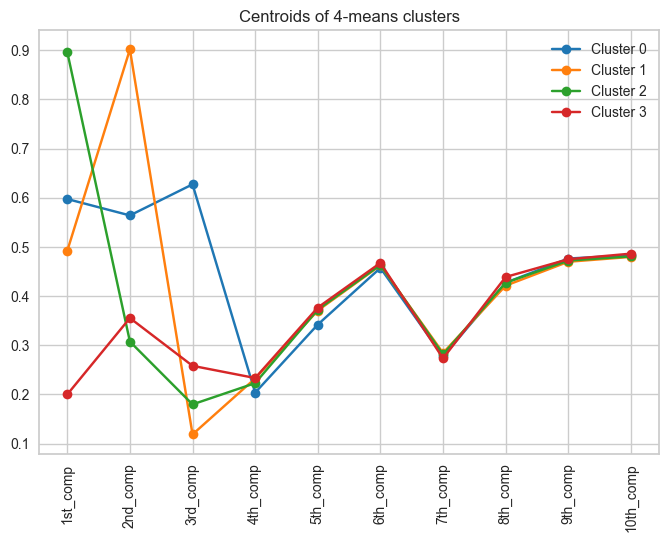

In [459]:
for j in range(0, len(centroids)):
    plt.plot(centroids[j], marker='o', label='Cluster %s' % j, c=sns.color_palette('tab10')[j])
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(clustered_components)), clustered_components, rotation=90)
plt.legend(fontsize=10)
plt.title(f'Centroids of {chosen_k}-means clusters');

We observe that, as expected, the first components are the ones that most characterize the centroids of the identified clusters, with diversity decreasing as we move through the principal components used.

We can now appreciate the initial choice of not using all the PCA components but only a subset of the most relevant ones, as the subsequent ones would have little influence on the result.

Let's remember that the first 3 principal components derived from PCA were correlated to the original features:
- 'n_arrested_prop'
- 'n_killed_prop'
- 'n_injured_prop'
- 'n_unharmed_prop'
- 'n_teen_prop'

So, we expect that the identified clusters primarily differ in these 4 features.

We visualize the same information using a interactive radar plot:

In [303]:
def plot_spider(points, features, title=None, palette=sns.color_palette(), save=False):
    df = pd.DataFrame()
    for i, center in enumerate(points):
        tmp_df = pd.DataFrame(dict(r=center, theta=features))
        tmp_df['Centroid'] = f'Centroid {i}'
        df = pd.concat([df,tmp_df], axis=0)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore", FutureWarning)
        fig = px.line_polar(df, r='r', theta='theta', line_close=True, color='Centroid', color_discrete_sequence=palette.as_hex())
    fig.update_layout(title=title)
    fig.show()
    if save:
        pyo.plot(fig, filename=f'../html/centroids_spider_PCA.html', auto_open=False)

In [304]:
plot_spider(points=centroids, features=clustered_components, title=f'Centroids of {chosen_k}-means clusters', palette=sns.color_palette('tab10'))

we create the function to convert back the centroid in the original features space

In [305]:
def inverse_trasform_k_comp(x_pca, pca, n_comp):
    return np.matmul(x_pca[:,:n_comp], pca.components_[:n_comp,:]) + pca.mean_

and now we create the same two graphs with the inverse transformation of the centroids 

In [306]:
transformed_centroids = inverse_trasform_k_comp(centroids, pca, 10)

In [307]:
plot_spider(points=transformed_centroids, features=features_to_cluster_no_coord, title=f'Centroids of {chosen_k}-means clusters', palette=sns.color_palette('tab10'), save=True)

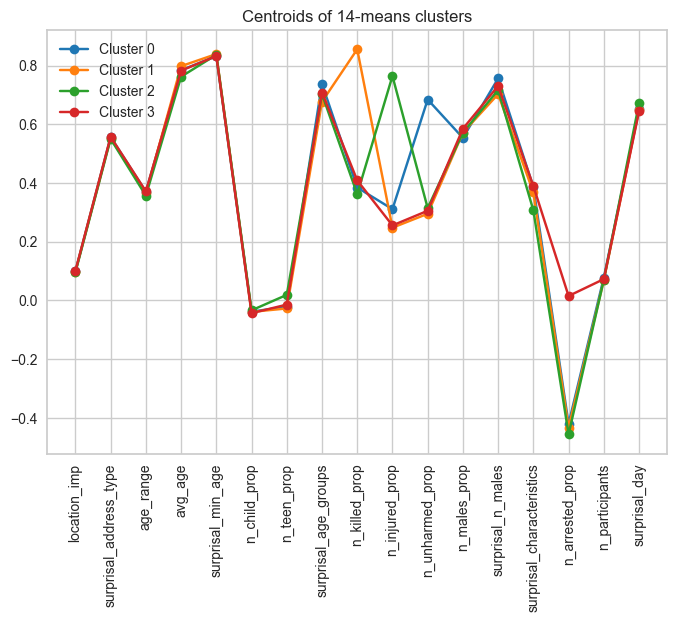

In [308]:
for j in range(0, len(centroids)):
    plt.plot(transformed_centroids[j], marker='o', label='Cluster %s' % j, c=sns.color_palette('tab10')[j])
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(features_to_cluster_no_coord)), features_to_cluster_no_coord, rotation=90)
plt.legend(fontsize=10)
plt.title(f'Centroids of {k}-means clusters');

Here we can observe a strange aspect of the centroids, namely that three of them have the value 'n_arrested_prop' less than zero, although this value always represents a proportion greater than zero. As a result of some tests condicted it turned out that the most important principal components had the same negative value and that due to the reconstruction error derived from using only the first 10 this value remains negative.

Ultimately, we can see what we had predicted, with clusters divided mainly into the components mentioned above, and we also note some obvious diversification in the features:

- 'avg_age'
- 'suprisal_n_males'
- 'suprisal_characteristics'

From the graphs above, we can say that the first 3 clusters (0, 1 and 2) are identified with each other as:
- 0: the cluster presenting the accidents in which many of the participants were unharmed
- 1: the cluster presenting the accidents in which many of the participants were killed
- 2: the cluster presenting the incidents in which many of the participants were injured but not killed 

For the last cluster, we note that it differs greatly from the previous ones in that it has a higher 'n_arrested_prop' quantity and a low value for all three features that distinguish the previous ones.

We note a slightly higher-than-average value for cluster 2 in the 'n_teen_prop' feature


For the sake of showing it below we see the main components defined by the PCA, whose co-ordinates of each record were used for clustering, in relation to the original features.



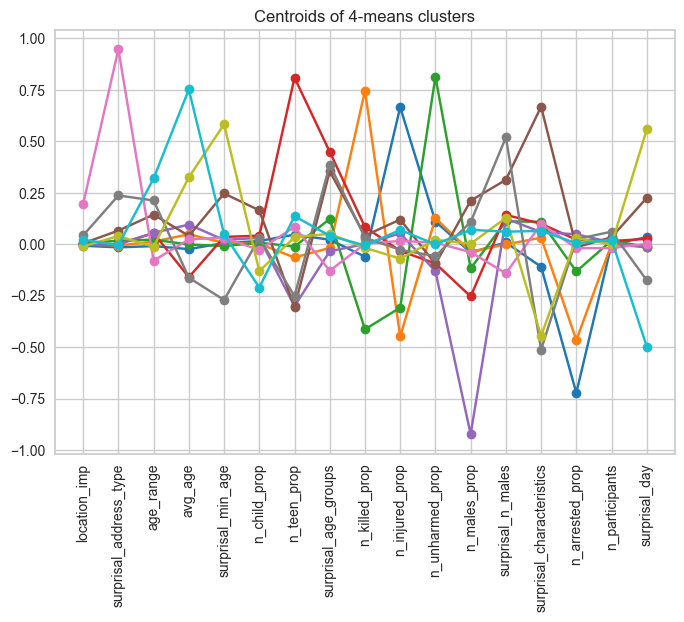

In [460]:
plot_spider(points=pca.components_[:10], features=features_to_cluster_no_coord, title=f'Centroids of {chosen_k}-means clusters', palette=sns.color_palette('tab10'))

for j in range(0, len(pca.components_[:10])):
    plt.plot(pca.components_[j], marker='o', label='Cluster %s' % j, c=sns.color_palette('tab10')[j])
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(features_to_cluster_no_coord)), features_to_cluster_no_coord, rotation=90)
plt.title(f'Centroids of {chosen_k}-means clusters');

However, it is difficult to make any assumptions as a result of this graph

In [457]:
most_identifying_columns = ['avg_age',
 'n_killed_prop',
 'n_injured_prop',
 'n_unharmed_prop',
 'n_males_prop',
 'surprisal_n_males',
 'n_arrested_prop',
 'surprisal_day']

## Distribution of variables within the 4 clusters

We plot on a map the points in each cluster:

In [301]:
plot_scattermap_plotly(
    incidents_df,
    'cluster',
    zoom=2.5,
    height=600,
    title=f'Point divided by cluster',
    black_nan=False
).show()

Incidents are not clustered according to their geographical location, all clusters are evenly distributed, even in areas with fewer incidents like Hawaii or Alaska.

Now we inspect the distribution of categorical features within the clusters:

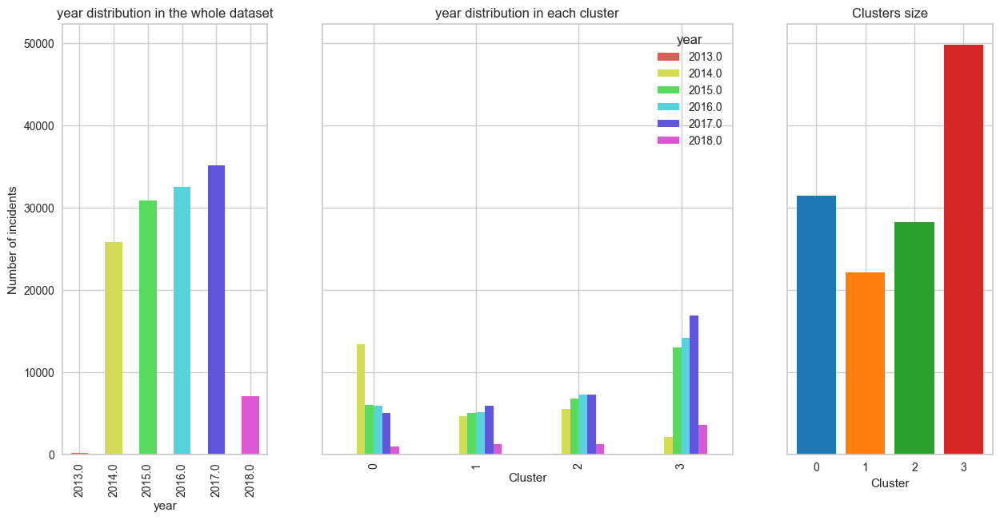

In [310]:
plot_bars_by_cluster(df=incidents_df, feature='year', cluster_column='cluster')

For clusters 1 and 2, the distribution of the year of the incident respects that of the entire dataset, but for cluster 0 and 3 we notice some differences.

These differences can be seen in the presence of incidents occurring in 2014, which are scarcely present in cluster 3 and very present in cluster 0. It is currently difficult to understand the reason for the disproportionality, but it could mean a higher presence of an incident type represented in cluster 0 in that year, as we have already studied how the date does not correlate with any other feature directly

In [347]:
incidents_df.loc[incidents_df['year']==2014.0].describe()[features_to_cluster_no_coord]

,location_imp,surprisal_address_type,age_range,avg_age,surprisal_min_age,n_child_prop,n_teen_prop,surprisal_age_groups,n_killed_prop,n_injured_prop,n_unharmed_prop,n_males_prop,surprisal_n_males,surprisal_characteristics,n_arrested_prop,n_participants,surprisal_day
count,2.587400e+04,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000,25874.000000
mean,1.538016e-02,1.448300,3.915939,30.295045,4.660649,0.013315,0.070726,2.457913,0.234085,0.289425,0.387231,0.853493,1.979149,3.705849,0.066539,1.965564,5.486566
std,4.998616e-02,1.434740,8.828470,12.790472,1.101723,0.100046,0.235341,1.487953,0.367183,0.390405,0.403275,0.261810,1.221860,1.626836,0.214640,1.160093,1.160186
min,1.000000e-07,-0.000000,0.000000,1.000000,-0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000,-0.000000,0.000000,1.000000,-0.000000
25%,1.000000e-07,0.444785,0.000000,21.000000,3.906891,0.000000,0.000000,1.415037,0.000000,0.000000,0.000000,0.666667,1.133267,2.459432,0.000000,1.000000,4.718818
50%,1.000000e-07,0.777608,0.000000,27.000000,4.554589,0.000000,0.000000,1.968291,0.000000,0.000000,0.400000,1.000000,1.624491,3.565854,0.000000,2.000000,5.523562
75%,1.000000e-05,2.192645,3.000000,36.000000,5.321928,0.000000,0.000000,3.111508,0.500000,0.500000,0.666667,1.000000,2.415037,4.906891,0.000000,2.000000,6.285402
max,5.584028e-01,8.682995,79.000000,101.000000,9.271463,1.000000,1.000000,9.271463,1.000000,1.000000,1.000000,1.000000,8.682995,9.271463,1.000000,20.000000,9.271463


In [349]:
incidents_df.loc[incidents_df['year']>2014.0].describe()[features_to_cluster_no_coord]

,location_imp,surprisal_address_type,age_range,avg_age,surprisal_min_age,n_child_prop,n_teen_prop,surprisal_age_groups,n_killed_prop,n_injured_prop,n_unharmed_prop,n_males_prop,surprisal_n_males,surprisal_characteristics,n_arrested_prop,n_participants,surprisal_day
count,1.057540e+05,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000,105754.000000
mean,1.317844e-02,1.397060,3.323534,30.181024,4.968146,0.011320,0.076411,2.314066,0.217208,0.302138,0.102766,0.878613,1.825876,3.795250,0.384326,1.774571,5.781167
std,4.343735e-02,1.478241,7.925659,12.230416,1.073769,0.095811,0.247185,1.593001,0.358518,0.395956,0.230398,0.255843,1.285837,1.672906,0.421839,1.074995,1.125654
min,1.000000e-07,-0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000,-0.000000,0.000000,1.000000,-0.000000
25%,1.000000e-07,0.395929,0.000000,21.000000,4.224966,0.000000,0.000000,1.180572,0.000000,0.000000,0.000000,1.000000,0.925999,2.478047,0.000000,1.000000,5.044394
50%,1.000000e-05,0.660514,0.000000,27.000000,4.857981,0.000000,0.000000,1.766544,0.000000,0.000000,0.000000,1.000000,1.306661,3.700440,0.250000,2.000000,5.807355
75%,1.000000e-05,2.137504,2.000000,36.000000,5.614710,0.000000,0.000000,2.938599,0.500000,0.500000,0.000000,1.000000,2.297681,5.003752,1.000000,2.000000,6.544321
max,6.467426e-01,9.489848,82.000000,101.000000,9.614710,1.000000,1.000000,9.614710,1.000000,1.000000,1.000000,1.000000,9.489848,9.614710,1.000000,63.000000,9.614710


| year | n_participants mean | n_arrested mean/ratio | n_unharmed mean/ratio |
| :- | -: | -: | -: |
| =2014 | 1.965 | 0.066 / 0.033 | 0.387 / 0.196 |
| >2014 | 1.774 | 0.384 / 0.216 | 0.102 / 0.001 |

As theorised, we note that in 2014, the average number of arrestees is 0.06 and the proportion between the average number of arrestees and participants is 0.03, whereas in subsequent years the two values are much higher and correspond to 0.38 and 0.21.

For the number of uninjured participants, on the other hand, is the opposite of the expected result.

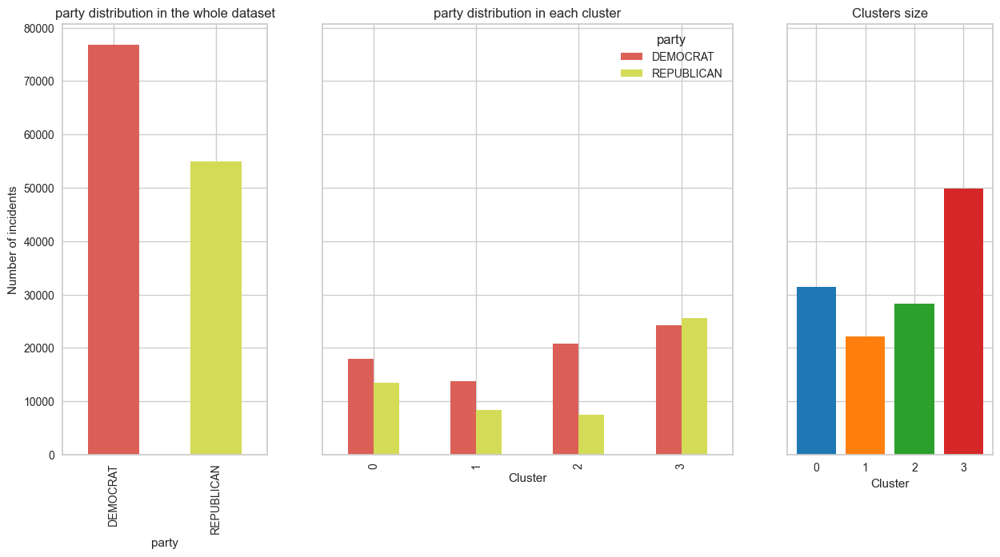

In [311]:
plot_bars_by_cluster(df=incidents_df, feature='party', cluster_column='cluster')

All clusters respect the distribution except for cluster 3, we can theorise that in incidents occurring in republican states, the number of arrests tends to be higher, perhaps as a result of differences in laws.

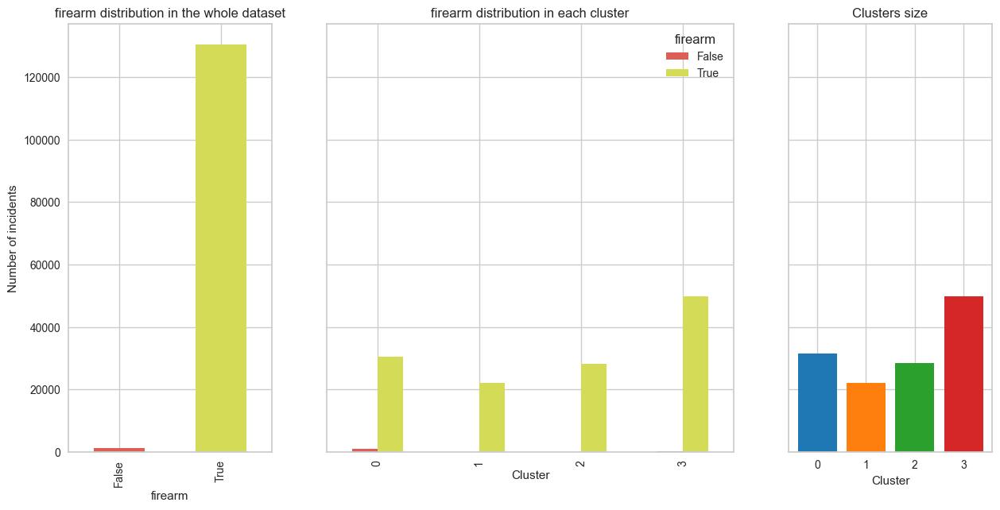

In [312]:
plot_bars_by_cluster(df=incidents_df, feature='firearm', cluster_column='cluster')

In [353]:
dummy_df = incidents_df[
    (incidents_df['firearm']==False)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df


,cluster,percentage
0,946,0.758013
3,171,0.137019
2,77,0.061699
1,54,0.043269


Almost all incidents that did not involve firearms are included in the cluster with the highest number of uninjured participants. Very interesting information and yet more proof of the lethality of firearms, which therefore cause more injuries and deaths.
The cluster 3, identifiable by generally low values of killed, injured, and unharmed individuals, and high values of arrests, includes these incidents.

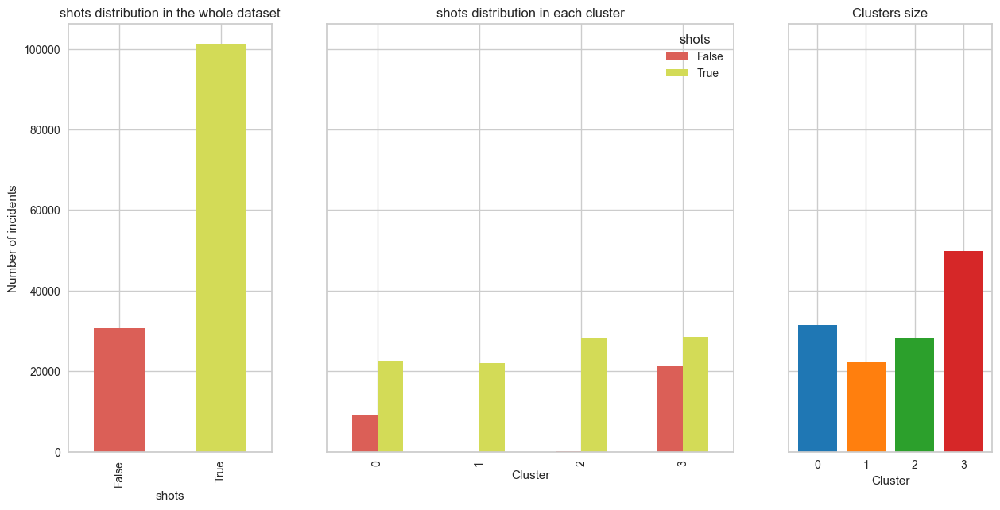

In [313]:
plot_bars_by_cluster(df=incidents_df, feature='shots', cluster_column='cluster')

The vast majority of incidents within clusters 1 and 2 are characterized by firearm shots and are the incidents that respectively caused the most killed and injured. Cluster 3 shows a slight disproportion in favor of the absence of the tag.

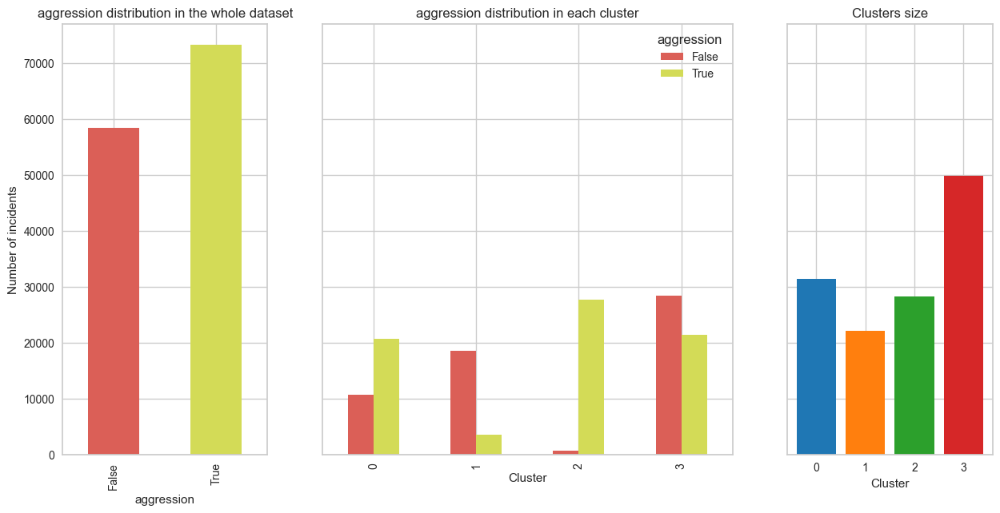

In [315]:
plot_bars_by_cluster(df=incidents_df, feature='aggression', cluster_column='cluster')

As expected, cluster 3 predominantly comprises non-aggression incidents, while cluster 2, on the contrary, almost entirely comprises incidents tagged as 'aggression'. Cluster 0 shows no differences compared to the general distribution, as if the tag were not influential. Strangely, in cluster 1, identified with the highest number of deaths among participants, it presents the largest difference between aggression and non-aggression incidents. This implies that the majority of aggressions do not result in fatalities and do result in injured.

In [382]:
incidents_df.groupby('aggression').describe()[['n_killed_prop', 'n_injured_prop', 'n_arrested_prop']]

n_killed_prop                                                    \
                   count      mean       std  min  25%       50%  75%  max   
aggression                                                                   
False            58449.0  0.415296  0.428928  0.0  0.0  0.333333  1.0  1.0   
True             73362.0  0.065454  0.179670  0.0  0.0  0.000000  0.0  1.0   

           n_injured_prop                                               \
                    count      mean       std  min  25%  50%  75%  max   
aggression                                                               
False             58449.0  0.019555  0.119545  0.0  0.0  0.0  0.0  1.0   
True              73362.0  0.523447  0.395273  0.0  0.0  0.5  1.0  1.0   

           n_arrested_prop                                               
                     count      mean       std  min  25%  50%  75%  max  
aggression                                                               
False              58449.0  0.430669  0.446516  0.0  0.0  0.5  1.0  1.0  
True               73362.0  0.234706  0.354490  0.0  0.0  0.0  0.5  1.0

As we were saying, we notice the difference in the average of fatalities, which increases to 0.415 when the tag is present and drops to 0.065 when it's not.

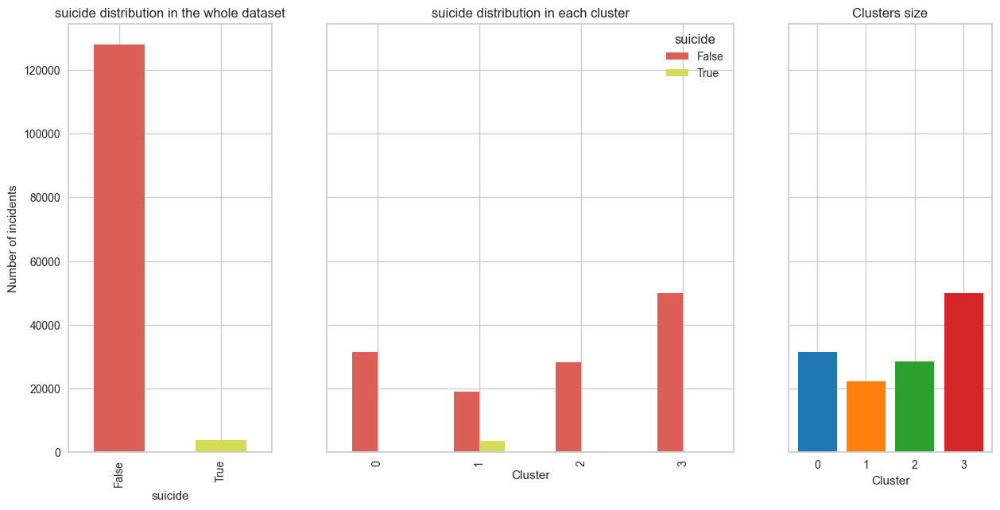

In [317]:
plot_bars_by_cluster(df=incidents_df, feature='suicide', cluster_column='cluster')

In [384]:
dummy_df = incidents_df[
    (incidents_df['suicide']==True)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
1,3350,0.925414
2,133,0.036740
0,70,0.019337
3,67,0.018508


While it is obvious, It is mandatory to state that suicides are almost entirely contained within cluster 1. It's also quite unexpected to find some instances of suicide in the other clusters.

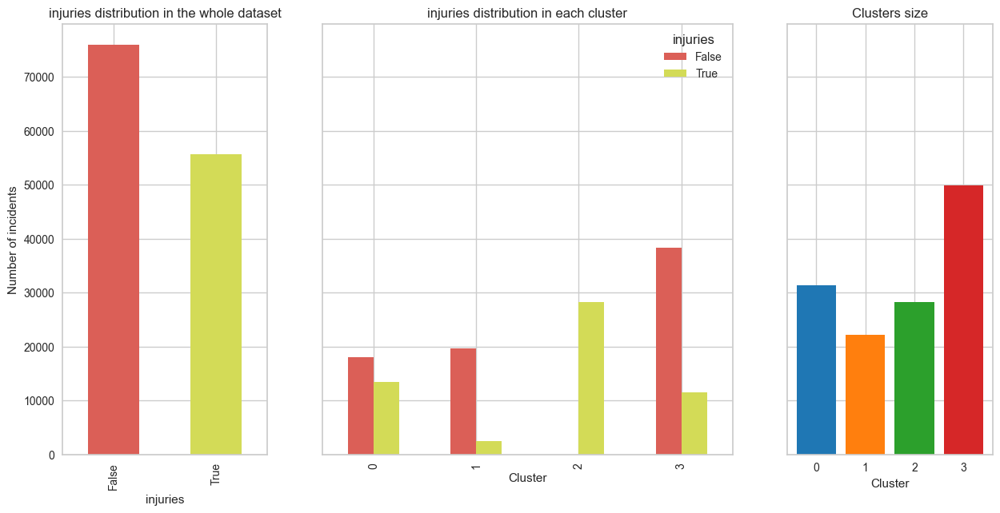

In [318]:
plot_bars_by_cluster(df=incidents_df, feature='injuries', cluster_column='cluster')

In [385]:
dummy_df = incidents_df[
    (incidents_df['injuries']==False)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
3,38383,0.504641
1,19669,0.258598
0,18008,0.236760


Here we can observe the most marked characterization of cluster 2, as it's entirely composed of incidents classified with the 'injuries' tag, indicating incidents that have resulted in injuries. Additionally, we notice how these mentioned incidents are less prevalent in cluster 1. Half of the incidents not classified as 'injuries' are contained within cluster 3, with the remainder evenly divided between clusters 0 and 1.

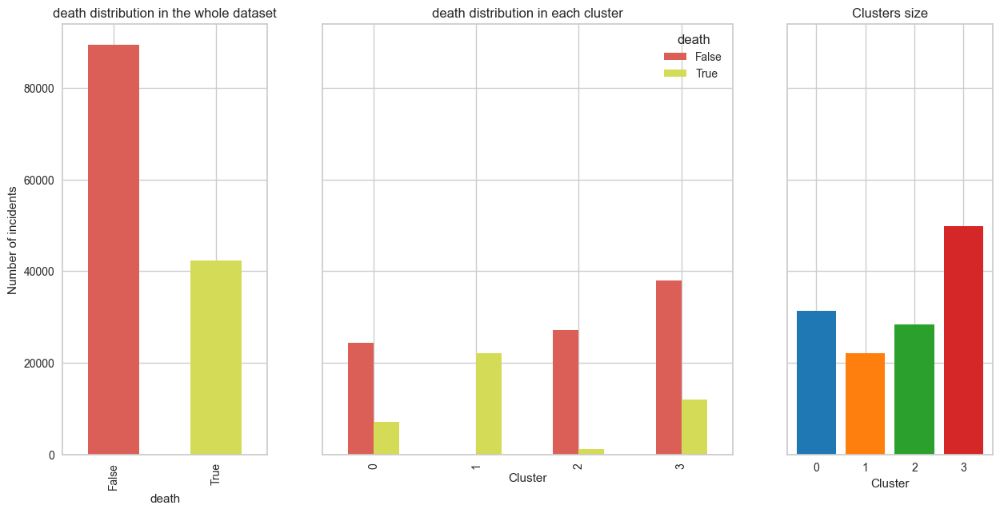

In [319]:
plot_bars_by_cluster(df=incidents_df, feature='death', cluster_column='cluster')

In [386]:
dummy_df = incidents_df[
    (incidents_df['death']==False)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
3,37931,0.423838
2,27214,0.304087
0,24349,0.272074


Here we can observe the most marked characterization of cluster 1, as it's entirely composed of incidents classified with the 'death' tag, indicating incidents that have resulted deaths. We also notice a negligible presence of these incidents in cluster 2.

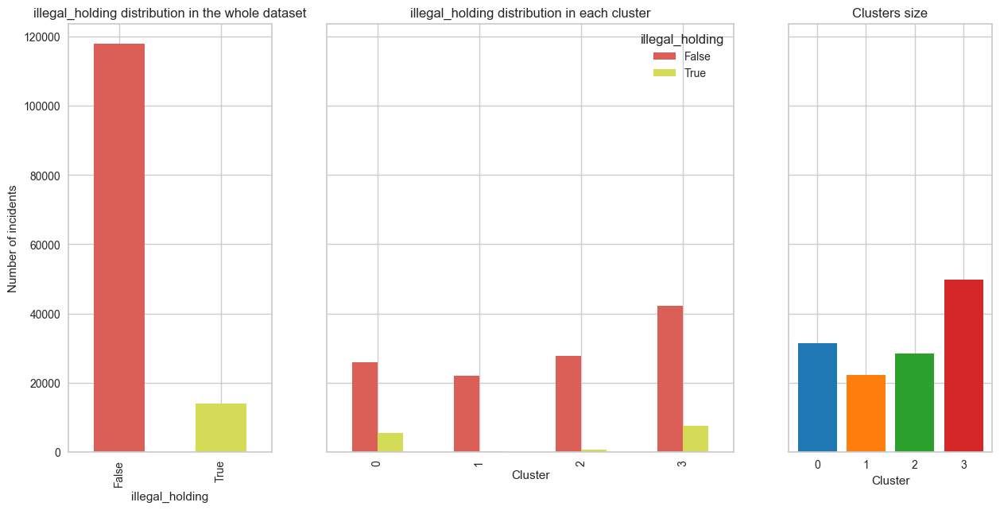

In [321]:
plot_bars_by_cluster(df=incidents_df, feature='illegal_holding', cluster_column='cluster')

In [415]:
dummy_df = incidents_df[
    (incidents_df['illegal_holding']==True)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
3,7610,0.546342
0,5515,0.395937
2,627,0.045014
1,177,0.012707


In clusters 1 and 2, we have a minimal presence of incidents tagged as 'illegal_holding', which are instead present in clusters 0 and 3.
We can observe that incidents where firearms were identified or seized for illegal possession did not result in injuries or fatalities. It's likely that a confrontation did not even occur.

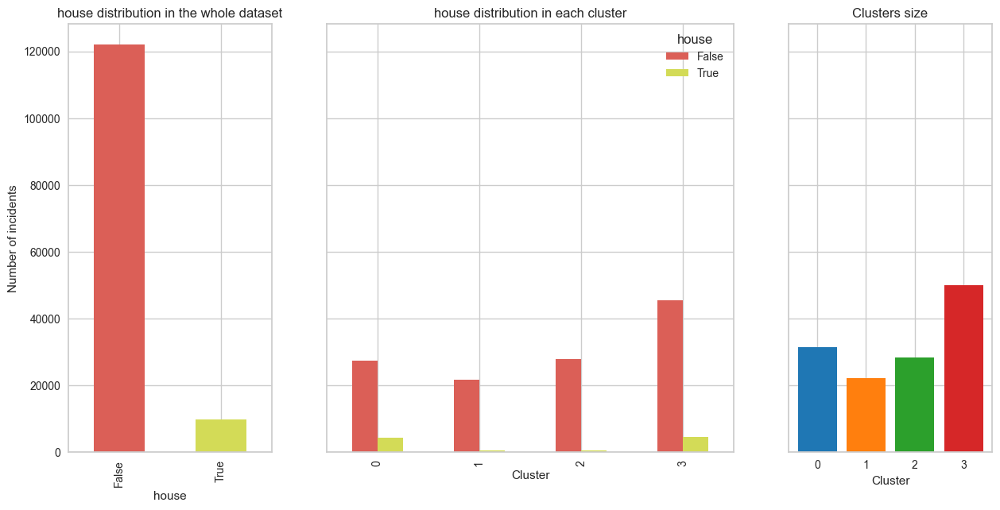

In [322]:
plot_bars_by_cluster(df=incidents_df, feature='house', cluster_column='cluster')

In [442]:
dummy_df = incidents_df[
    (incidents_df['house']==True)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
3,4510,0.466294
0,4154,0.429487
2,548,0.056658
1,460,0.047560


The same considerations we made previously apply to this tag as well, although in this case, it's more challenging to understand the reason behind it.

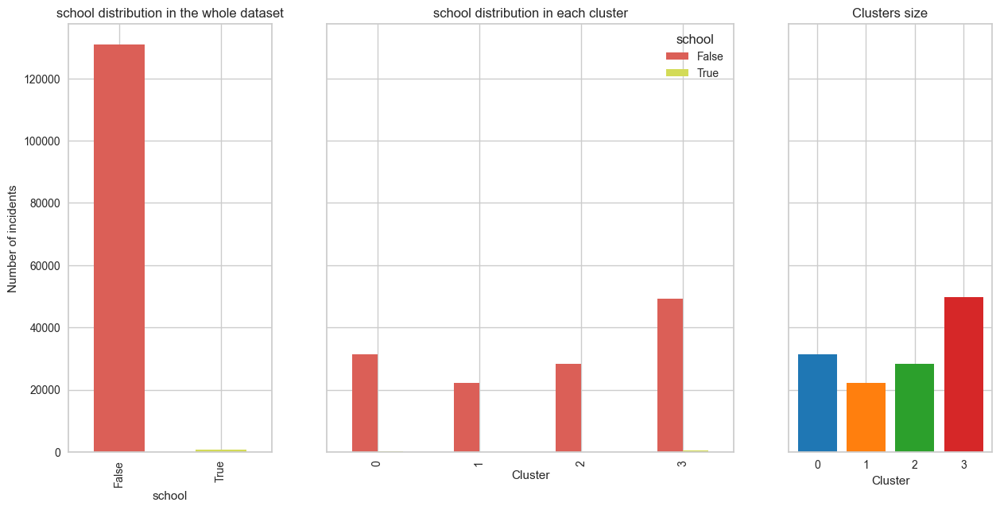

In [323]:
plot_bars_by_cluster(df=incidents_df, feature='school', cluster_column='cluster')

In [444]:
dummy_df = incidents_df[
    (incidents_df['school']==True)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
3,562,0.737533
0,166,0.217848
2,29,0.038058
1,5,0.006562


Here, we can observe that incidents that occurred in schools have, on average, resulted in many arrests, many unharmed individuals, and few injured or deceased. Contrary to what one might think, incidents that occurred in schools don't only involve the well-known 'school shootings', the majority of them involve few participants and a peaceful resolution of the event.

Most of the incidents involving children are in cluster 8 - the one having the highest value of n_child_prop. Some of them are in cluster 6 - the one with the highest value of age_range.

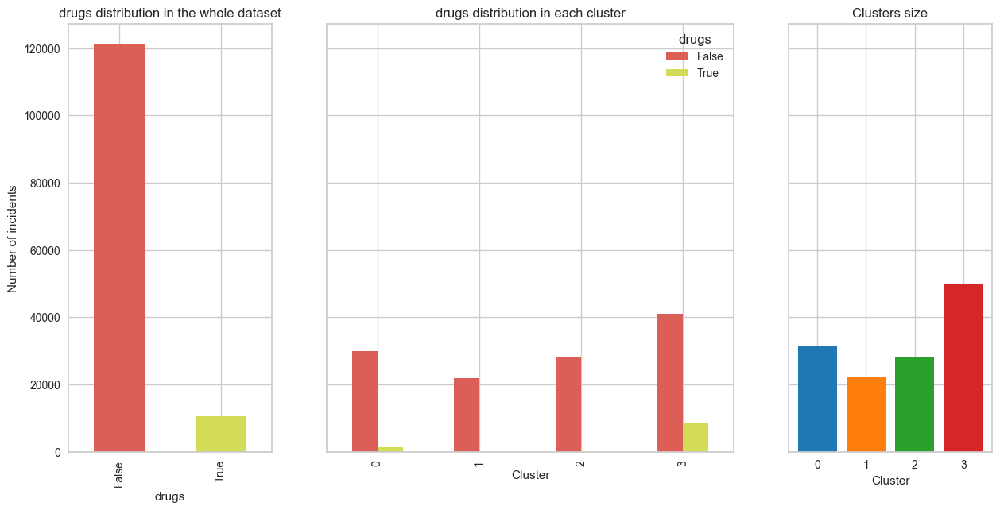

In [325]:
plot_bars_by_cluster(df=incidents_df, feature='drugs', cluster_column='cluster')

In [450]:
dummy_df = incidents_df[
    (incidents_df['drugs']==True)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
3,8797,0.827797
0,1403,0.132022
2,245,0.023054
1,182,0.017126


Even in this scenario, drugs don't entirely define the incidents across the clusters, but there's a notable distinction with cluster 3 compared to the others. This leads to the assumption that incidents involving illegal drug possession often have peaceful resolutions, frequently involving arrests by law enforcement.

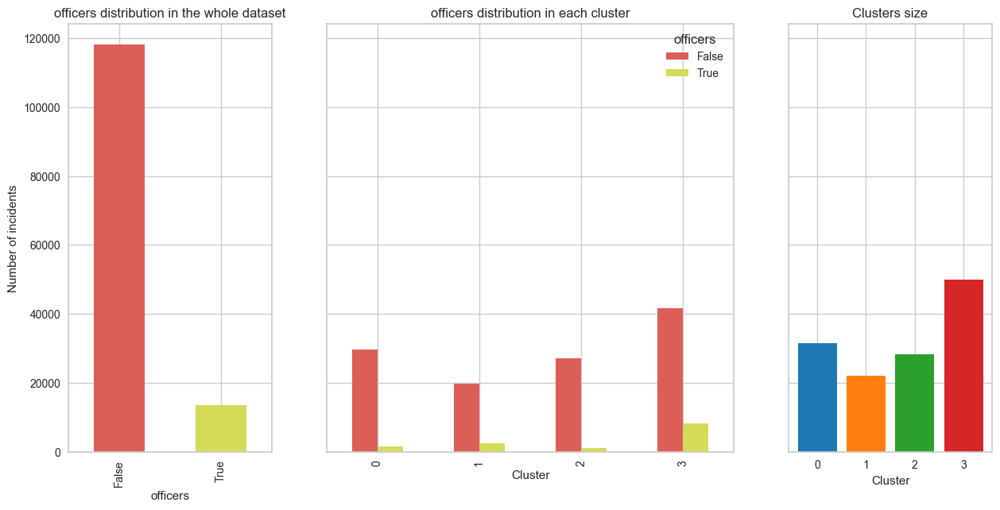

In [326]:
plot_bars_by_cluster(df=incidents_df, feature='officers', cluster_column='cluster')

Here, we observe that the presence of officers, denoted by the 'officers' tag, in the incident leads to a higher number of arrests.

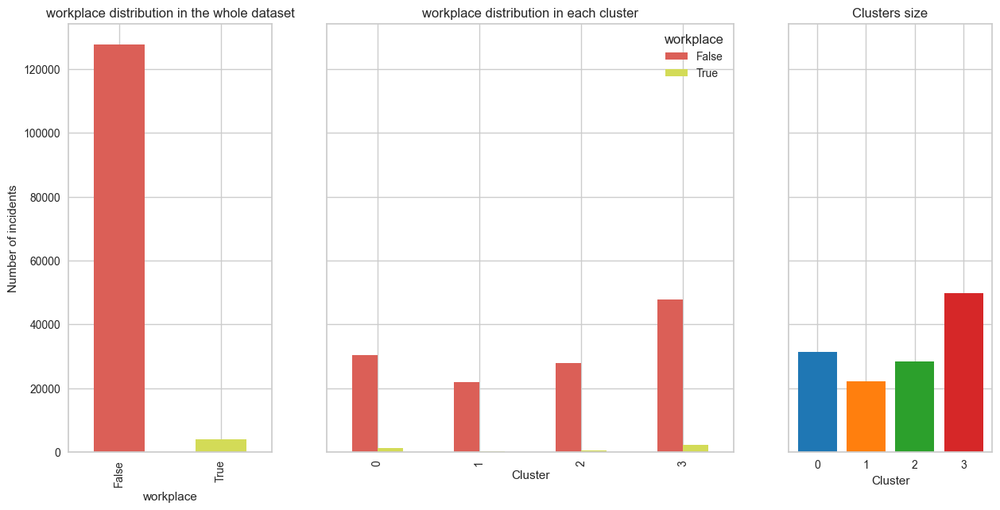

In [327]:
plot_bars_by_cluster(df=incidents_df, feature='workplace', cluster_column='cluster')

Similarly to the 'school' tag, the 'workplace' tag is more characteristic of clusters 3 and 0. Based on this conclusion, we can assert that, generally, incidents that occur inside buildings tend to conclude peacefully, often resulting in arrests.

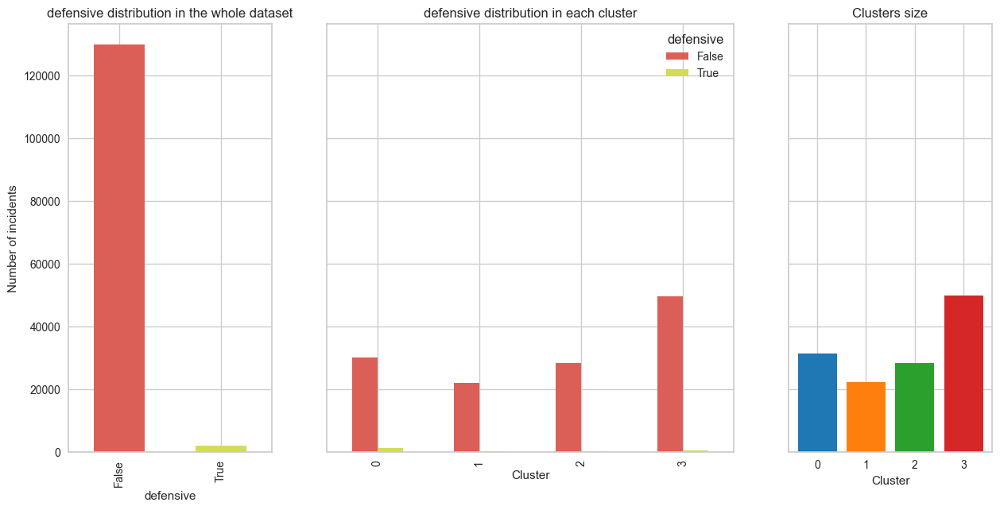

In [328]:
plot_bars_by_cluster(df=incidents_df, feature='defensive', cluster_column='cluster')

In [453]:
dummy_df = incidents_df[
    (incidents_df['defensive']==True)]['cluster'].value_counts().to_frame()
dummy_df['percentage'] = dummy_df['cluster']/sum(dummy_df['cluster'])
dummy_df

,cluster,percentage
0,1264,0.677022
3,392,0.209963
2,118,0.063203
1,93,0.049813


The majority of incidents identified as 'defensive' are included in cluster 0, which identifies a higher quantity of unharmed participants compared to the total and the other two categories.

Below, we visualize the identified clusters projected onto two of the most influential dimensions in the clustering, which are the following:
- 'n_teen_prop'
- 'surprisal_age_groups'
- 'n_killed_prop'
- 'n_injured_prop'
- 'n_unharmed_prop'
- 'n_males_prop'
- 'surprisal_n_males'
- 'surprisal_characteristics'
- 'n_arrested_prop'
- 'surprisal_day'

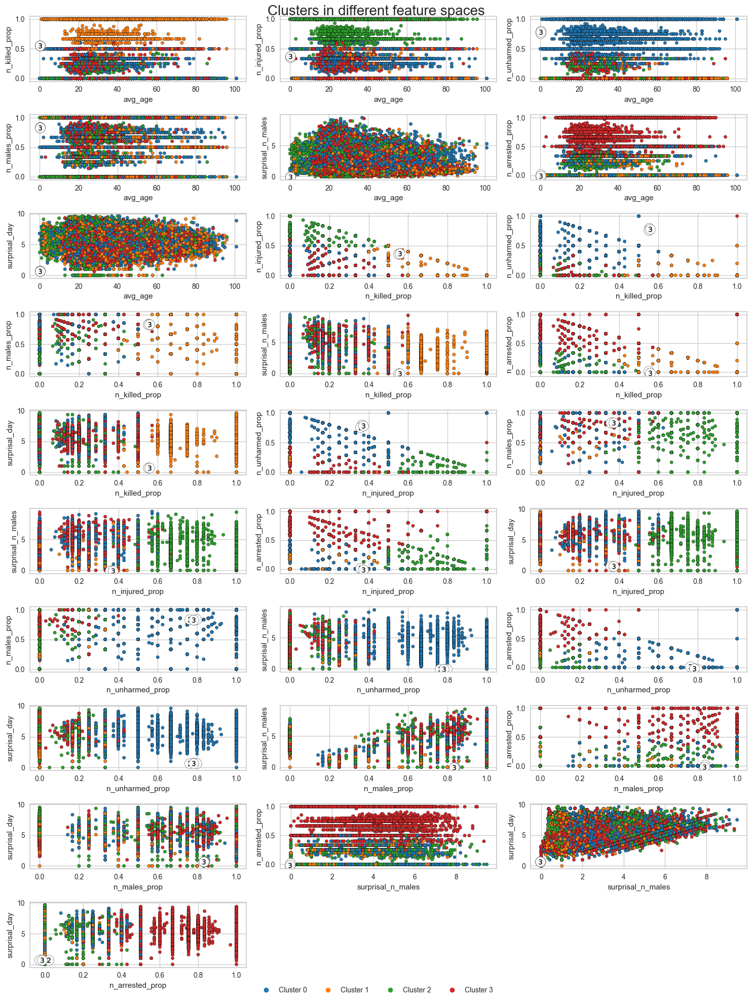

In [465]:
scatter_by_cluster(
    df=incidents_df,
    features=most_identifying_columns,
    cluster_column='cluster',
    centroids=transformed_centroids[:, [most_identifying_columns.index(feature) for feature in most_identifying_columns]],
    figsize=(15, 20),
    ncols=3,
    color_palette=sns.color_palette('tab10')
)
plt.tight_layout()

Below, we visualize the identified clusters in the space of the first 6 components of PCA. We can observe that the first principal components better differentiate the 4 clusters.

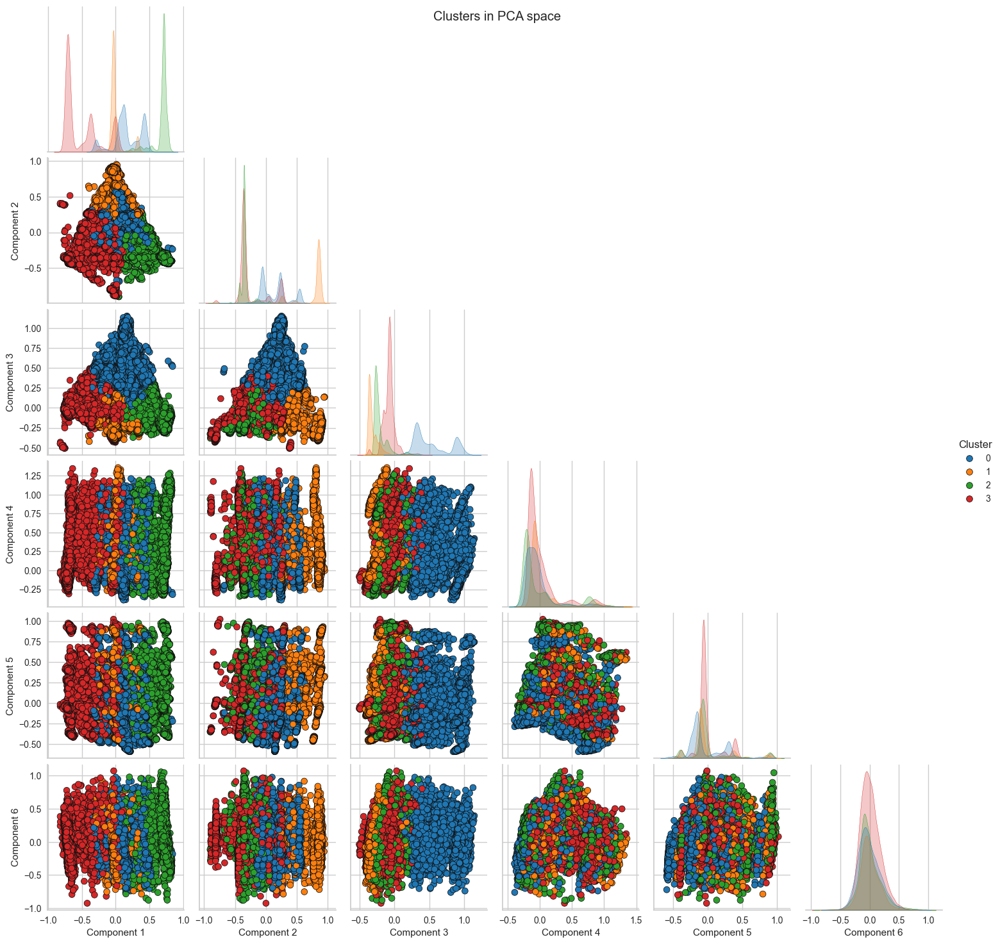

In [456]:
palette = [sns.color_palette('tab10')[i] for i in range(chosen_k)]
scatter_pca_features_by_cluster(
    X_pca=X_pca,
    n_components=6,
    clusters=incidents_df['cluster'],
    palette=palette,
    hue_order=None,
    title='Clusters in PCA space'
)

Below, we can observe the distributions of the features used for clustering, along with the coordinates for each identified cluster. By observing these, it's possible to confirm the statements made so far.

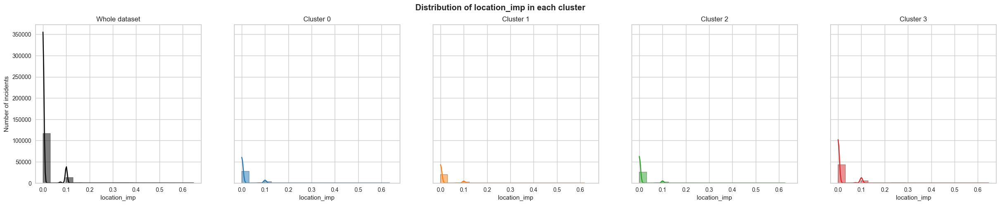

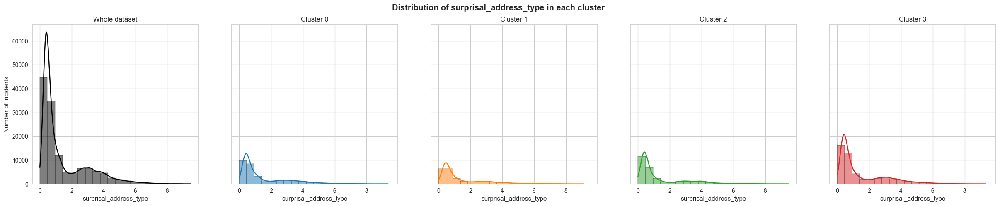

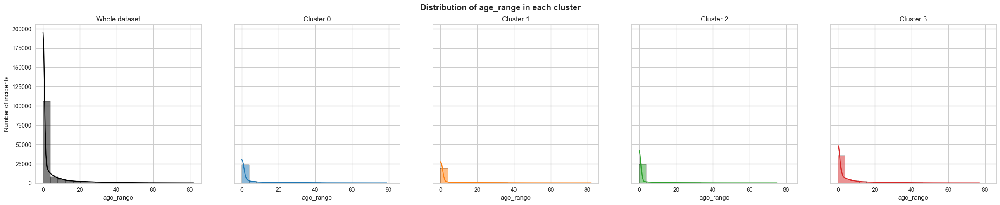

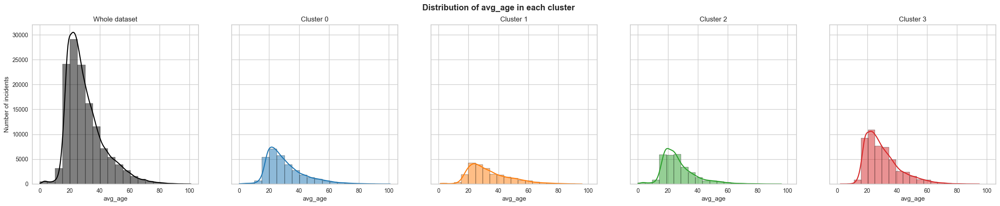

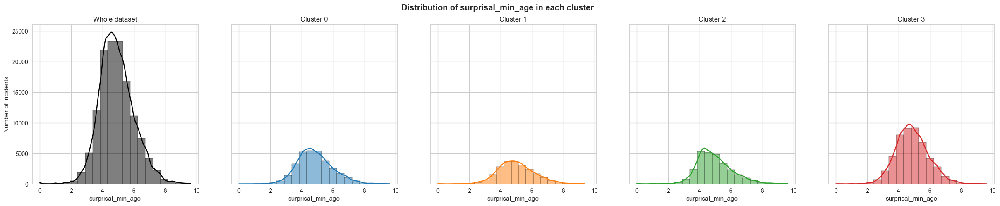

...

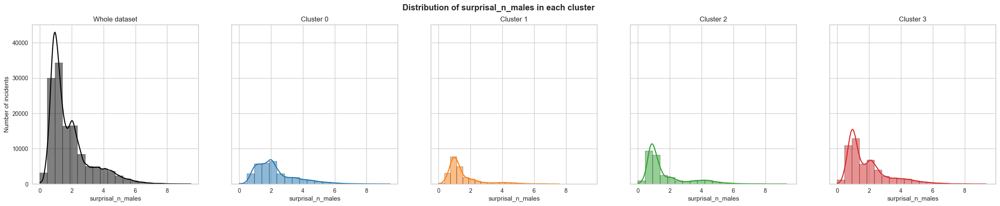

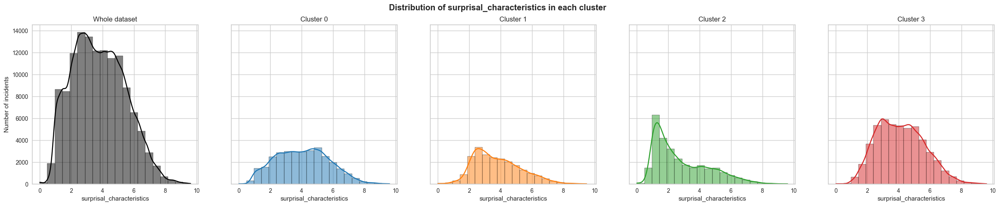

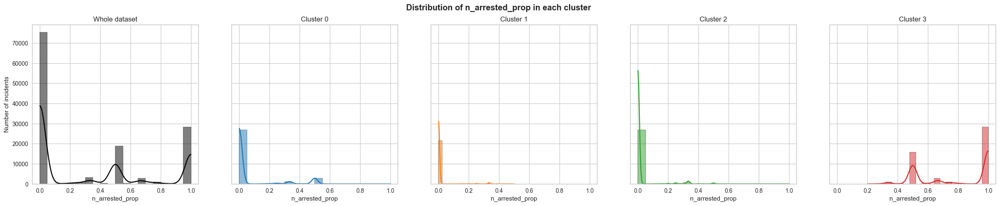

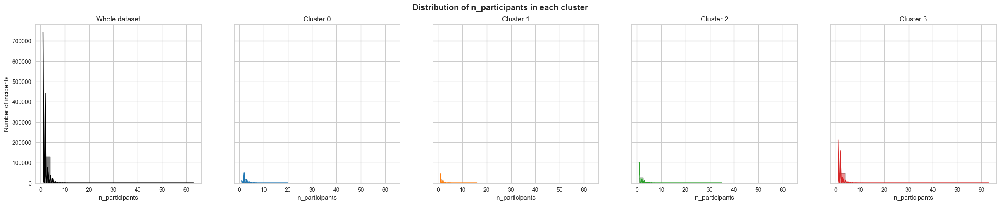

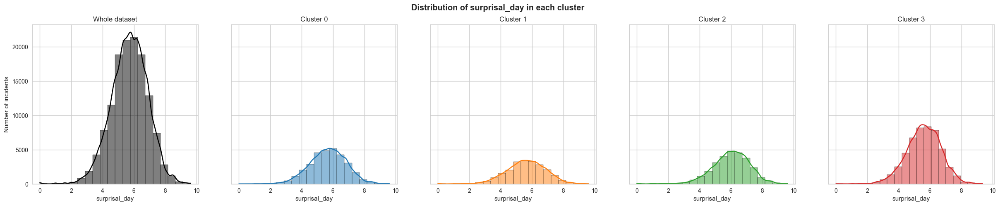

In [332]:
for feature in features_to_cluster:
    plot_hists_by_cluster(
        df=incidents_df,
        feature=feature,
        cluster_column='cluster',
        title=f'Distribution of {feature} in each cluster',
        color_palette=sns.color_palette('tab10'),
        figsize=(30, 5)
    )

The only additional insight we can draw from these graphs is that for incidents included in cluster 2, the variability of incident tags is lower than in the other clusters. This is highlighted by the distribution of 'suprisal_characterstics', which peaks around x = 1, indicating lower overall entropy.

In [429]:
sse_feature = []
for i in range(X.shape[1]):
    sse_feature.append(compute_se_per_point(X=X[:,i], clusters=clusters, centroids=transformed_centroids[:,i]).sum())

Text(0.5, 1.0, 'SSE per feature')

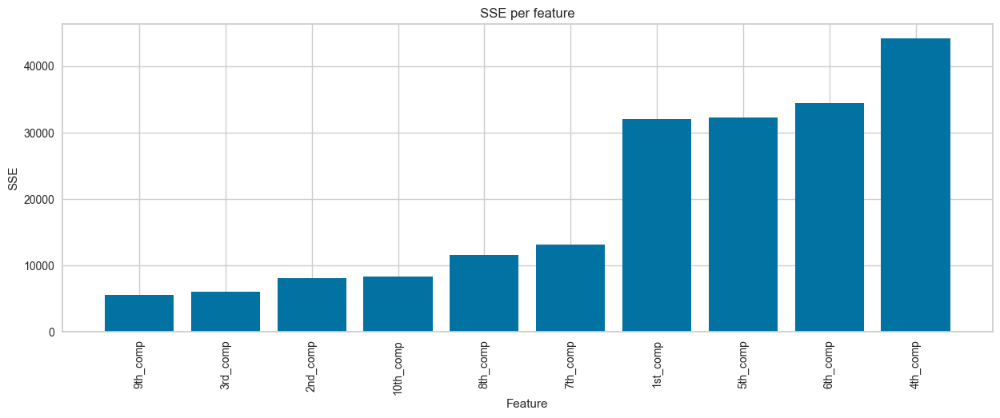

In [428]:
plt.figure(figsize=(15, 5))
sse_feature_sorted, clustering_features_sorted = zip(*sorted(zip(sse_feature, clustered_components)))
plt.bar(range(len(sse_feature_sorted)), sse_feature_sorted)
plt.xticks(range(len(sse_feature_sorted)), clustering_features_sorted)
plt.xticks(rotation=90)
plt.ylabel('SSE')
plt.xlabel('Feature')
plt.title('SSE per feature')

## Evaluation of the clustering results

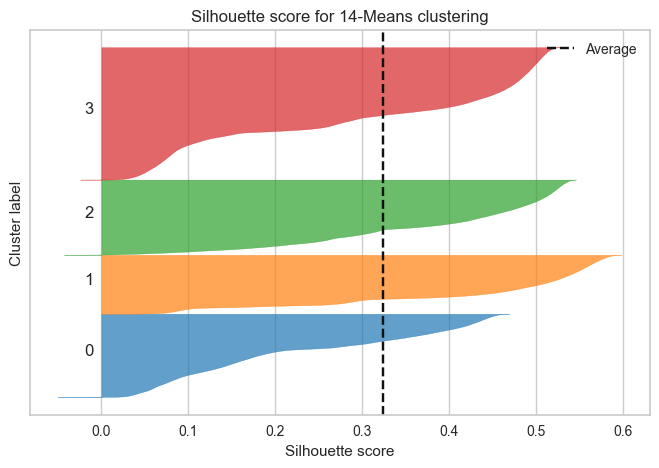

In [440]:
fig, axs = plt.subplots(1, figsize=(8,5))
silhouette_per_point = silhouette_samples(X=X, labels=clusters)
plot_scores_per_point(
    score_per_point=silhouette_per_point,
    clusters=incidents_df['cluster'],
    score_name='Silhouette score', ax=axs,
    title=f'Silhouette score for {k}-Means clustering',
    color_palette=sns.color_palette('tab10'),
    minx=-0.02
)

In [335]:
# print top 5 points with highest SSE
se_per_point = compute_se_per_point(X=X, clusters=clusters, centroids=centroids)
indices_of_top_contributors = np.argsort(se_per_point)[-5:]
incidents_df.iloc[indices_of_top_contributors]

,date,date_original,year,month,day,day_of_week,state,address,latitude,longitude,county,city,address_type,congd,state_house_district,state_senate_district,px_code,participant_age1,participant1_child,participant1_teen,participant1_adult,participant1_male,participant1_female,min_age,max_age,n_child,n_teen,n_adult,n_males,n_females,n_killed,n_injured,n_arrested,n_unharmed,notes,incident_characteristics1,incident_characteristics2,firearm,air_gun,shots,aggression,suicide,injuries,death,road,illegal_holding,house,school,children,drugs,officers,organized,social_reasons,defensive,workplace,abduction,unintentional,poverty_perc,party,candidate_votes,total_votes,candidate_perc,population_state_2010,lat_proj,lon_proj,location_imp,surprisal_address_type,age_range,avg_age,surprisal_min_age,log_min_age_mean_ratio,n_child_prop,n_teen_prop,surprisal_age_groups,severity,n_killed_prop,surprisal_n_killed,log_n_killed_mean_ratio,n_injured_prop,log_n_injured_mean_ratio,surprisal_n_injured,n_unharmed_prop,n_males_prop,log_n_males_mean_ratio,surprisal_n_males,surprisal_characteristics,n_arrested_prop,log_n_participants_mean_ratio,surprisal_n_participants,n_participants,surprisal_day,cluster
116805,2014-07-19,2014-07-19,2014.0,7,19,5,CALIFORNIA,12th and Filbert,37.8074,-122.2830,Alameda County,Oakland,amenity,13.0,18.0,9.0,CA,10.0,True,False,False,False,True,10.0,10.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,NaN,Shot - Wounded/Injured,NaN,True,False,True,True,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,14.5,DEMOCRAT,168491.0,190431.0,88.478767,37253956,563115.378637,4.184688e+06,0.000010,3.543543,0.0,10.0,9.271463,-1.038644,1.0,0.0,8.271463,0.3,0.0,0.104045,0.003328,1.0,2.192754,3.464108,0.0,0.0,0.002256,6.464108,9.271463,0.0,-0.644059,2.913911,1.0,9.271463,2
185844,2015-01-01,2015-01-01,2015.0,1,1,3,WISCONSIN,2700 block of N. Holton St,43.0675,-87.9053,Milwaukee County,Milwaukee,tourism,4.0,16.0,6.0,WI,15.0,False,True,False,False,True,15.0,15.0,0.0,2.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,Teen seriously wounded after New Years shooting.,Shot - Wounded/Injured,NaN,True,False,True,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,10.5,DEMOCRAT,179045.0,254892.0,70.243476,5686986,426291.101979,4.768708e+06,0.000010,7.539159,0.0,15.0,4.731804,-0.546545,0.0,1.0,6.539159,0.3,0.0,0.516791,0.003328,0.5,0.191550,0.909802,0.5,0.0,0.002256,4.217231,1.349334,0.0,0.176110,1.954196,2.0,7.539159,0
109349,2014-04-30,2014-04-30,2014.0,4,30,2,SOUTH CAROLINA,NaN,32.2860,-80.7214,Beaufort County,NaN,county,1.0,123.0,46.0,SC,12.0,False,True,False,False,True,12.0,12.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,NaN,"Shot - Dead (murder, accidental, suicide)",Suicide^,True,False,True,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,14.9,REPUBLICAN,119392.0,127815.0,93.410007,4625364,526233.291331,3.572171e+06,0.475885,6.303781,0.0,12.0,6.303781,-0.761491,0.0,1.0,5.303781,0.7,1.0,2.303781,1.597534,0.0,0.003328,0.373043,0.0,0.0,0.002256,6.303781,6.303781,0.0,-0.785174,2.216318,1.0,6.303781,1
102815,2017-01-14,2017-01-14,2017.0,1,14,5,LOUISIANA,2200 block of Westbend Parkway,29.9297,-90.0196,Orleans Parish,New Orleans,leisure,2.0,102.0,7.0,LA,0.0,True,False,False,False,True,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1 inj,Shot - Wounded/Injured,Child Involved Incident,True,False,True,True,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,19.1,DEMOCRAT,198289.0,284269.0,69.754001,4533372,787720.693084,3.314731e+06,0.000010,9.129283,0.0,0.0,9.129283,0.000259,1.0,0.0,8.129283,0.3,0.0,0.371060,0.003328,1.0,0.384787,1.057821,0.0,0.0,0.002256,4.374396,6.807355,0.0,-0.511643,0.830075,1.0,6.807355,2
214525,2017-01-18,2017-01-18,2017.0,1,18,2,LOUISIANA,5100 Oaklon Avenue,30.5087,-91.1414,East Baton Rouge Parish,Baton Rouge,tourism,2.0,29.0,14.0,LA,15.0,False,True,False,False,True,15.0,15.0,0.0,1.0,0.0,0.0,1.0,1.0,0

All these points have an high number of participants.

The number of participants contributes a lot to the SSE.

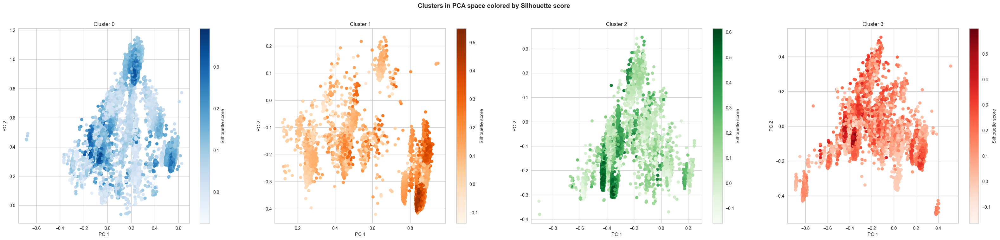

In [423]:
scatter_pca_features_by_score(
    X_pca=X_pca,
    clusters=incidents_df['cluster'],
    x_component=1,
    y_component=2,
    score_per_point=silhouette_per_point,
    score_name='Silhouette score',
    cmaps=['Blues', 'Oranges', 'Greens', 'Reds', 'Purples', 'YlOrBr', 'PuRd', 'Greys', 'Wistia', 'GnBu'],
    figsize=(40, 8)
)

c:\Users\Geco\anaconda3\envs\DM_Proj\Lib\site-packages\sklearn\manifold\_mds.py:298: FutureWarning:

The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.



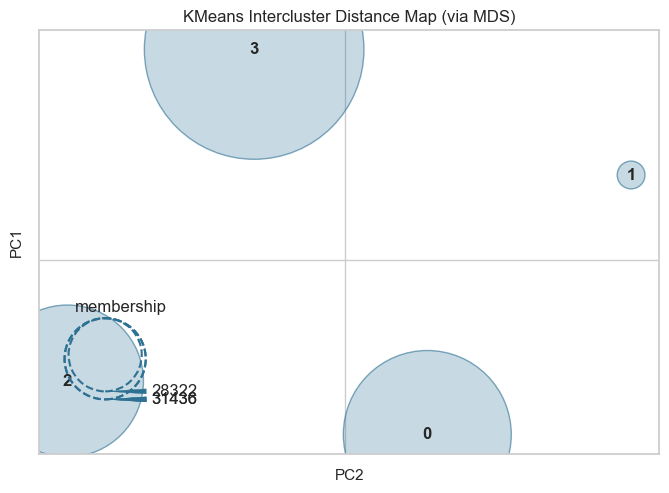

In [466]:
visualizer = InterclusterDistance(kmeans)
visualizer.fit(X)
visualizer.show();

Text(0.5, 0.98, 'Cohesion and separation measures for each cluster')

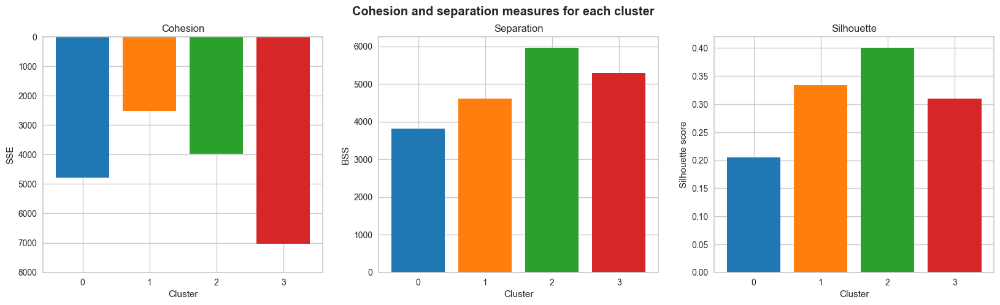

In [439]:
# compute cohesion for each cluster
se_per_cluster = np.zeros(chosen_k)
sizes = np.ones(centroids.shape[0])
for i in range(chosen_k):
    se_per_cluster[i] = np.sum(se_per_point[np.where(clusters == i)[0]])/sizes[i] # TODO: weigthed (or not?)
# compute separation for each cluster
bss_per_cluster = compute_bss_per_cluster(X, clusters, centroids, weighted=True) # TODO: weigthed (or not?)
# compute average silhouette score for each cluster
silhouette_per_cluster = np.zeros(chosen_k)
for i in range(chosen_k):
    silhouette_per_cluster[i] = silhouette_per_point[np.where(clusters == i)[0]].mean() # TODO: already weighted

# visualize the result
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(20,5))
axs[0].bar(range(chosen_k), se_per_cluster, color=sns.color_palette('tab10'))
axs[0].set_ylim(8000, 0)
axs[0].set_title('Cohesion')
axs[0].set_ylabel('SSE')
axs[1].bar(range(chosen_k), bss_per_cluster, color=sns.color_palette('tab10'))
axs[1].set_title('Separation')
axs[1].set_ylabel('BSS')
axs[2].bar(range(chosen_k), silhouette_per_cluster, color=sns.color_palette('tab10'))
axs[2].set_title('Silhouette')
axs[2].set_ylabel('Silhouette score')

for i in range(3):
    axs[i].set_xlabel('Cluster')
    axs[i].set_xticks(range(chosen_k))
    axs[i].set_xticklabels(range(chosen_k))

plt.suptitle('Cohesion and separation measures for each cluster', fontweight='bold')

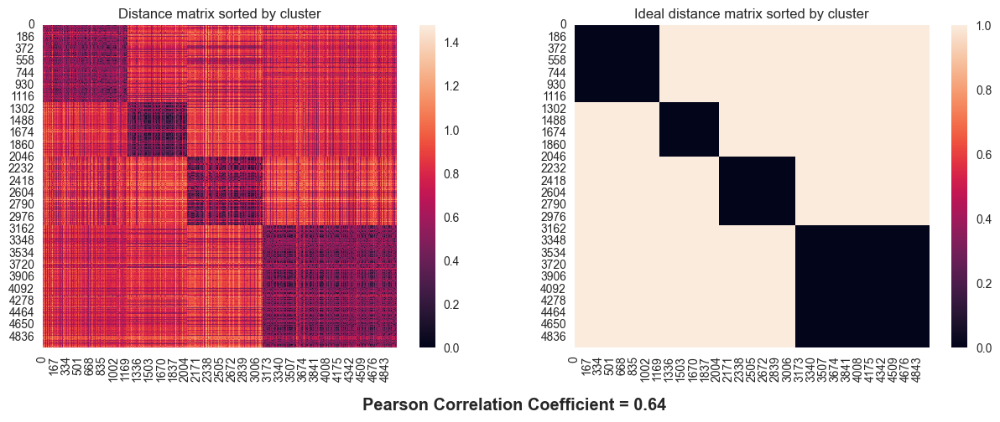

In [340]:
dm, idm = plot_distance_matrices(X=X, n_samples=5000, clusters=clusters, random_state=RANDOM_STATE)

The pearson correlation coefficient between the two matrix is 0.64. Indeed, the matrix has a sharp block diagonal structure, meaning that clusters are well separated.

### External indices

We measure the extent to which the discovered clustering structure matches some categorical features of the dataset, using the following permutation invariant scores:
- **Adjusted rand score**: this score computes a similarity measure between two clusterings by considering all pairs of samples and counting pairs that are assigned in the same or different clusters in the predicted and true clusterings. It is 0 for random labeling, 1.0 when the clusterings are identical and is bounded below by -0.5 for especially discordant clusterings.
- **Normalized mutual information**: is a normalization of the Mutual Information (MI) score to scale the results between 0 (no mutual information) and 1 (perfect correlation). Mutual Information is a function that measures the agreement of the two assignments, ignoring permutations.
- **Homogeneity**: measure the degree to which each cluster contains only members of a single class; it ranges between 0 and 1, with 1 denoting perfectly homogeneous labeling.
- **Completeness**: measure the degree to ewhich data points that are members of a given class are also elements of the same cluster; it ranges between 0 and 1, with 1 denoting perfectly complete labeling.

In [417]:
incidents_df['unharmed'] = incidents_df['n_unharmed'] > 0
incidents_df['arrested'] = incidents_df['n_arrested'] > 0
external_score = compute_permutation_invariant_external_metrics(
    incidents_df,
    'cluster',
    ['shots', 'aggression', 'suicide', 'injuries', 'death', 'drugs', 'illegal_holding', 'unharmed', 'arrested']
)
external_score

,adjusted rand score,normalized mutual information,homogeneity,completeness
feature,,,,
shots,0.013098,0.135908,0.235928,0.095445
aggression,0.119408,0.174358,0.257281,0.131859
suicide,0.018048,0.055002,0.320398,0.030083
injuries,0.196766,0.252092,0.373973,0.190128
death,0.167238,0.260939,0.409001,0.191583
drugs,-0.021250,0.051653,0.149292,0.031229
illegal_holding,-0.012607,0.040955,0.101807,0.025633
unharmed,0.339517,0.501209,0.841450,0.356898
arrested,0.453665,0.514149,0.761589,0.388066


In [451]:
incidents_df['cluster'].to_csv(f'../data/clustering_labels/{chosen_k}-Means_PCA_clusters.csv')
external_score.to_csv(f'../data/clustering_labels/{chosen_k}-Means_PCA_external_scores.csv')
pd.DataFrame(final_result, index=['4means PCA']).T.to_csv(f'../data/clustering_labels/{chosen_k}-Means_PCA_internal_scores.csv')

## Final considerations 

After studying the clustering algorithm's behavior with various 'k' values identified through different scores, it was possible to apply k-means with 'k = 4' to the PCA decomposition of the selected features for clustering, yielding good results.

The identified clusters distinguish themselves well from each other, especially concerning some original features such as:
- 'n_arrested_prop'
- 'n_killed_prop'
- 'n_injured_prop'
- 'n_unharmed_prop'
- 'n_teen_prop'

Furthermore, it was possible to observe the divergence of the clusters, although not overly pronounced, concerning the remaining features used in clustering. It was then feasible to confirm this diversification through a meticulous study correlating the clustering results with all the original categorical features in the dataframe, particularly with the tags. 

Finally, we can consider ourselves satisfied with the scores achieved by the clustering, as they are not optimal but good, as observable from the correlation matrix.